# Image Colorization Using Deep Convolutional Neural Networks
## BBM 418 - Assignment 3

**Student Name:** Ahmet Oğuzhan Kökülü  
**Student Number:** b2220356053

**Demo Video Link:** https://drive.google.com/file/d/162fJkQlsCYCMWshmQMo9gr7oszW2ETEE/view?usp=drive_link

**Dataset Drive Link:** https://drive.google.com/drive/folders/12lfa_UkMO9aBJGw989s1h1UDF-NbrDa9?usp=sharing

---

## Overview
This notebook implements an image colorization system using Deep Convolutional Neural Networks (DCNNs) with an encoder-decoder architecture. The model takes grayscale images (L channel from L*a*b* color space) as input and predicts the corresponding color channels (a* and b*).

## 1. Import Required Libraries

In [1]:
import os
import random
import numpy as np
import pandas as pd
from PIL import Image
from tqdm import tqdm
import matplotlib.pyplot as plt
from pathlib import Path
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
import torchvision
import torchvision.transforms as transforms
from torchvision import models
from skimage import color, io
from skimage.metrics import structural_similarity as ssim
from skimage.metrics import peak_signal_noise_ratio as psnr
import warnings
warnings.filterwarnings('ignore')

# Set random seeds for reproducibility
SEED = 42
random.seed(SEED)
np.random.seed(SEED)
torch.manual_seed(SEED)
torch.cuda.manual_seed(SEED)
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False

# Device configuration
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
if torch.cuda.is_available():
    print(f"GPU Name: {torch.cuda.get_device_name(0)}")

GPU Name: NVIDIA L4


## 2. Introduction

Image colorization is the process of adding realistic colors to grayscale images.

In this assignment, we use an encoder-decoder architecture with Deep Convolutional Neural Networks (DCNNs) to learn the mapping between grayscale images and their colorized versions.

### L*a*b* Color Space

We use the L*a*b* color space (CIELAB) which has three components:
- **L***: Lightness (0 for black to 100 for white)
- **a***: Green-to-red spectrum
- **b***: Blue-to-yellow spectrum

This color space is ideal for colorization because it separates brightness (L*) from color information (a*, b*). We use:
- **Input**: L channel (grayscale image)
- **Target**: a and b channels (color information)

## 3. Dataset Preparation

### 3.1 Configuration and Paths

In [2]:
from google.colab import drive
import shutil
import zipfile
import os

drive.mount('/content/drive')

# setup data paths
drive_zip_path = '/content/drive/MyDrive/val2017/val2017.zip'
local_zip_path = '/content/val2017.zip'
local_extract_path = '/content/dataset_local'

# extract
if not os.path.exists(local_extract_path):
    print("Copying dataset from Drive to local runtime...")
    shutil.copy(drive_zip_path, local_zip_path)
    with zipfile.ZipFile(local_zip_path, 'r') as zip_ref:
        zip_ref.extractall(local_extract_path)

else:
    print("Dataset already exists")

if os.path.exists(os.path.join(local_extract_path, 'val2017')):
    DATASET_PATH = os.path.join(local_extract_path, 'val2017')
else:
    DATASET_PATH = local_extract_path

OUTPUT_PATH = '/content/drive/MyDrive/val2017/outputs'
MODEL_PATH = '/content/drive/MyDrive/val2017/models'

# Image configuration
IMG_SIZE = 256
BATCH_SIZE = 128
NUM_WORKERS = 8

# Training configuration
NUM_EPOCHS = 32
LEARNING_RATE = 0.001
TRAIN_SPLIT = 0.8

print(f"TRAINING Data Path (Fast): {DATASET_PATH}")
print(f"SAVING Path (Safe): {OUTPUT_PATH}")

Mounted at /content/drive
Copying dataset from Drive to local runtime...
TRAINING Data Path (Fast): /content/dataset_local/val2017
SAVING Path (Safe): /content/drive/MyDrive/val2017/outputs


### 3.2 Prepare Dataset Split from Drive

This function creates train/test split indices from color images in Drive (no local copying).

In [3]:
def prepare_dataset_split(color_images_dir, train_split=0.8):
    """
    Prepare train/test split from color images in Google Drive.
    Returns lists of image file paths without copying files.

    Args:
        color_images_dir: Directory containing color images in Google Drive
        train_split: Ratio of training images

    Returns:
        train_files: List of training image paths
        test_files: List of test image paths
    """
    print(f"Scanning images from: {color_images_dir}")

    # Get all image files
    image_files = []
    for ext in ['*.jpg', '*.jpeg', '*.png', '*.JPG', '*.JPEG', '*.PNG']:
        image_files.extend(list(Path(color_images_dir).glob(ext)))

    print(f"Found {len(image_files)} color images")

    if len(image_files) == 0:
        raise ValueError(f"No images found in {color_images_dir}. Please check the path.")

    # Shuffle with fixed seed for reproducibility
    random.seed(SEED)
    random.shuffle(image_files)

    # Split into train and test
    split_idx = int(len(image_files) * train_split)
    train_files = image_files[:split_idx]
    test_files = image_files[split_idx:]

    print(f"\nDataset split:")
    print(f"  Training images: {len(train_files)}")
    print(f"  Test images: {len(test_files)}")
    print(f"  Train/Test ratio: {train_split}/{1-train_split}")

    return train_files, test_files

train_image_files, test_image_files = prepare_dataset_split(DATASET_PATH, TRAIN_SPLIT)

Scanning images from: /content/dataset_local/val2017
Found 5000 color images

Dataset split:
  Training images: 4000
  Test images: 1000
  Train/Test ratio: 0.8/0.19999999999999996


### 3.3 Dataset Class

In [4]:
class ColorizationDataset(Dataset):
    """
    Dataset class for image colorization.
    Loads color images directly from Google Drive and converts to L*a*b* on-the-fly.
    Returns L channel as input and ab channels as target.
    """
    def __init__(self, image_files, img_size=256, transform=None):
        """
        Args:
            image_files: List of Path objects pointing to color images in Drive
            img_size: Size to resize images to
            transform: Optional transforms to apply
        """
        self.image_files = image_files
        self.img_size = img_size
        self.transform = transform

        print(f"Initialized dataset with {len(self.image_files)} images")

    def __len__(self):
        return len(self.image_files)

    def __getitem__(self, idx):
        # Load color image directly from Drive
        img_path = str(self.image_files[idx])

        try:
            # Read RGB image
            img_rgb = io.imread(img_path)

            # Convert to RGB if grayscale or RGBA
            if len(img_rgb.shape) == 2:
                img_rgb = np.stack([img_rgb] * 3, axis=-1)
            elif img_rgb.shape[2] == 4:
                img_rgb = img_rgb[:, :, :3]

            # Resize
            img_pil = Image.fromarray(img_rgb)
            img_pil = img_pil.resize((self.img_size, self.img_size), Image.LANCZOS)
            img_rgb = np.array(img_pil)

            # Convert RGB to L*a*b* color space
            img_lab = color.rgb2lab(img_rgb).astype(np.float32)

            # Split into L and ab channels
            L = img_lab[:, :, 0]  # Lightness channel
            ab = img_lab[:, :, 1:]  # Color channels (a*, b*)

            # Normalize L to [0, 1] (L is in range [0, 100])
            L = L / 100.0

            # Normalize ab to [-1, 1] (ab is approximately in range [-128, 127])
            ab = ab / 128.0

            # Convert to tensors
            L = torch.FloatTensor(L).unsqueeze(0)  # Shape: (1, H, W)
            ab = torch.FloatTensor(ab).permute(2, 0, 1)  # Shape: (2, H, W)

            if self.transform:
                # Apply same transform to both L and ab
                seed = np.random.randint(2147483647)
                random.seed(seed)
                torch.manual_seed(seed)
                L = self.transform(L)
                random.seed(seed)
                torch.manual_seed(seed)
                ab = self.transform(ab)

            return L, ab, img_lab  # Return original lab_img for visualization

        except Exception as e:
            print(f"Error loading image {img_path}: {e}")
            # Return a black image as fallback
            L = torch.zeros(1, self.img_size, self.img_size)
            ab = torch.zeros(2, self.img_size, self.img_size)
            lab_img = np.zeros((self.img_size, self.img_size, 3), dtype=np.float32)
            return L, ab, lab_img

### 3.4 Create Data Loaders

In [5]:
# Create datasets from Drive image files
train_dataset = ColorizationDataset(train_image_files, img_size=IMG_SIZE)
test_dataset = ColorizationDataset(test_image_files, img_size=IMG_SIZE)

train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True,
                         num_workers=NUM_WORKERS, pin_memory=True)

val_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=False,
                        num_workers=NUM_WORKERS, pin_memory=True)
test_loader = val_loader

print(f"Training set: {len(train_dataset)} images, {len(train_loader)} batches")
print(f"Validation/Test set: {len(test_dataset)} images, {len(val_loader)} batches")

Initialized dataset with 4000 images
Initialized dataset with 1000 images
Training set: 4000 images, 32 batches
Validation/Test set: 1000 images, 8 batches


### 3.5 Visualize Sample Images and L*a*b* Channels

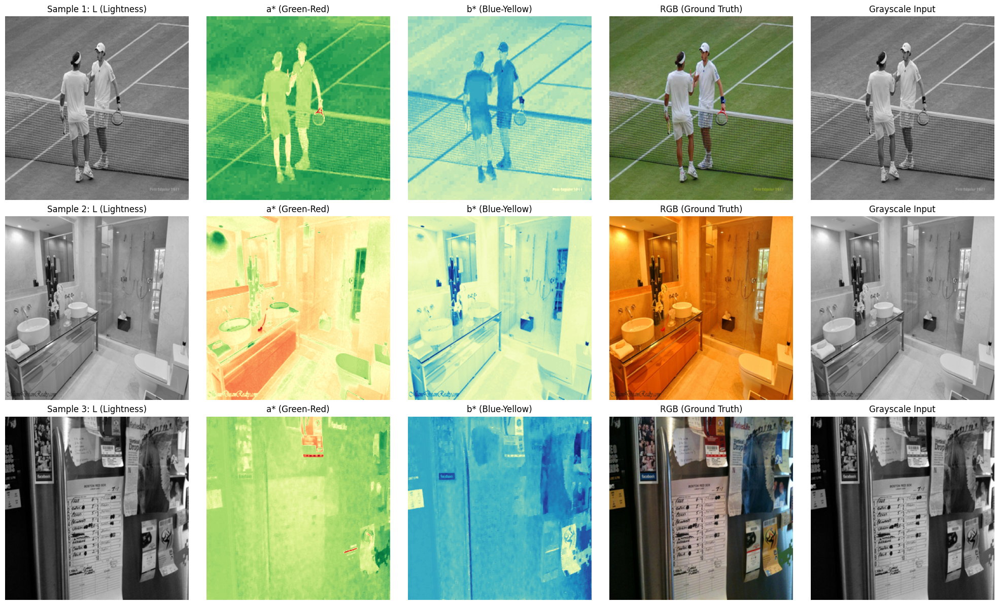

In [6]:
def visualize_lab_channels(dataset, num_samples=3):
    """Visualize L, a, b channels separately for sample images."""
    fig, axes = plt.subplots(num_samples, 5, figsize=(20, 4 * num_samples))

    for i in range(num_samples):
        L, ab, lab_img = dataset[i]

        # Convert back from tensors
        L_img = (L.squeeze().numpy() * 100.0).astype(np.float32)
        ab_img = (ab.permute(1, 2, 0).numpy() * 128.0).astype(np.float32)

        # Reconstruct full LAB image
        lab_reconstructed = np.zeros((IMG_SIZE, IMG_SIZE, 3), dtype=np.float32)
        lab_reconstructed[:, :, 0] = L_img
        lab_reconstructed[:, :, 1:] = ab_img

        # Convert to RGB
        rgb_img = color.lab2rgb(lab_reconstructed)

        # Plot
        axes[i, 0].imshow(L_img, cmap='gray')
        axes[i, 0].set_title(f'Sample {i+1}: L (Lightness)')
        axes[i, 0].axis('off')

        axes[i, 1].imshow(ab_img[:, :, 0], cmap='RdYlGn_r')
        axes[i, 1].set_title('a* (Green-Red)')
        axes[i, 1].axis('off')

        axes[i, 2].imshow(ab_img[:, :, 1], cmap='YlGnBu_r')
        axes[i, 2].set_title('b* (Blue-Yellow)')
        axes[i, 2].axis('off')

        axes[i, 3].imshow(rgb_img)
        axes[i, 3].set_title('RGB (Ground Truth)')
        axes[i, 3].axis('off')

        # Show grayscale version
        axes[i, 4].imshow(L_img, cmap='gray')
        axes[i, 4].set_title('Grayscale Input')
        axes[i, 4].axis('off')

    plt.tight_layout()
    plt.show()

visualize_lab_channels(train_dataset, num_samples=3)

## 4. Model Architecture

### 4.1 Low-Level Feature Extraction Network

This network extracts local spatial features from the input grayscale image.

In [7]:
class LowLevelFeatureExtractor(nn.Module):
    """
    Low-level feature extraction network.
    Follows the architecture from Figure 3:
    Conv1-6 with progressive downsampling from 256x256 -> 128x128 -> 64x64 -> 32x32
    """
    def __init__(self):
        super(LowLevelFeatureExtractor, self).__init__()

        # Conv1-2: 256x256 -> 128x128
        self.conv1 = nn.Conv2d(1, 64, kernel_size=3, stride=2, padding=1)  # 256->128
        self.bn1 = nn.BatchNorm2d(64)
        self.conv2 = nn.Conv2d(64, 128, kernel_size=3, stride=1, padding=1)
        self.bn2 = nn.BatchNorm2d(128)

        # Conv3-4: 128x128 -> 64x64
        self.conv3 = nn.Conv2d(128, 128, kernel_size=3, stride=2, padding=1)  # 128->64
        self.bn3 = nn.BatchNorm2d(128)
        self.conv4 = nn.Conv2d(128, 256, kernel_size=3, stride=1, padding=1)
        self.bn4 = nn.BatchNorm2d(256)

        # Conv5-6: 64x64 -> 32x32
        self.conv5 = nn.Conv2d(256, 256, kernel_size=3, stride=2, padding=1)  # 64->32
        self.bn5 = nn.BatchNorm2d(256)
        self.conv6 = nn.Conv2d(256, 512, kernel_size=3, stride=1, padding=1)
        self.bn6 = nn.BatchNorm2d(512)

        self.relu = nn.ReLU(inplace=True)

    def forward(self, x):
        # Input: (B, 1, 256, 256)
        x = self.relu(self.bn1(self.conv1(x)))  # (B, 64, 128, 128)
        x = self.relu(self.bn2(self.conv2(x)))  # (B, 128, 128, 128)

        x = self.relu(self.bn3(self.conv3(x)))  # (B, 128, 64, 64)
        x = self.relu(self.bn4(self.conv4(x)))  # (B, 256, 64, 64)

        x = self.relu(self.bn5(self.conv5(x)))  # (B, 256, 32, 32)
        x = self.relu(self.bn6(self.conv6(x)))  # (B, 512, 32, 32)

        return x  # Output: (B, 512, 32, 32)

### 4.2 Global Feature Extraction Network (Baseline)

This network extracts global context features. I'll start with a simple baseline, then integrate pretrained models.

In [8]:
class GlobalFeatureExtractor(nn.Module):
    """
    Global feature extraction network (baseline).
    Extracts global context with Conv7-8 to produce a 1000-dimensional feature vector.
    """
    def __init__(self):
        super(GlobalFeatureExtractor, self).__init__()

        # Conv7-8: Further process features
        self.conv7 = nn.Conv2d(1, 512, kernel_size=3, stride=2, padding=1)  # Assuming input from original image
        self.bn7 = nn.BatchNorm2d(512)
        self.conv8 = nn.Conv2d(512, 256, kernel_size=3, stride=2, padding=1)
        self.bn8 = nn.BatchNorm2d(256)

        self.relu = nn.ReLU(inplace=True)
        self.pool = nn.AdaptiveAvgPool2d((1, 1))

        # Fully connected layers to produce 1000-dim feature vector
        self.fc1 = nn.Linear(256, 1024)
        self.fc2 = nn.Linear(1024, 1000)
        self.dropout = nn.Dropout(0.5)

    def forward(self, x):
        # Input: (B, 1, H, W) - original grayscale image
        x = self.relu(self.bn7(self.conv7(x)))
        x = self.relu(self.bn8(self.conv8(x)))

        x = self.pool(x)  # (B, 256, 1, 1)
        x = x.view(x.size(0), -1)  # (B, 256)

        x = self.relu(self.fc1(x))
        x = self.dropout(x)
        x = self.fc2(x)  # (B, 1000)

        return x

### 4.3 Fusion Block

Combines low-level features with global features.

In [9]:
class FusionBlock(nn.Module):
    """
    Fusion block that combines low-level features (B, 512, 32, 32)
    with global features (B, 1000) into a fused representation (B, 256, 32, 32).
    """
    def __init__(self):
        super(FusionBlock, self).__init__()

        # Project global features to spatial dimensions
        self.fc = nn.Linear(1000, 256 * 32 * 32)

        # Combine low-level (512 channels) + global (256 channels) = 768 channels
        self.conv_fuse = nn.Conv2d(512 + 256, 256, kernel_size=1)
        self.bn = nn.BatchNorm2d(256)
        self.relu = nn.ReLU(inplace=True)

    def forward(self, low_level_features, global_features):
        # low_level_features: (B, 512, 32, 32)
        # global_features: (B, 1000)

        batch_size = low_level_features.size(0)

        # Project global features to spatial map
        global_spatial = self.fc(global_features)  # (B, 256*32*32)
        global_spatial = global_spatial.view(batch_size, 256, 32, 32)  # (B, 256, 32, 32)

        # Concatenate along channel dimension
        fused = torch.cat([low_level_features, global_spatial], dim=1)  # (B, 768, 32, 32)

        # Reduce channels
        fused = self.relu(self.bn(self.conv_fuse(fused)))  # (B, 256, 32, 32)

        return fused

### 4.4 Decoder Network

The decoder progressively upsamples the fused features to predict the ab channels.

In [10]:
class Decoder(nn.Module):
    """
    Decoder network that upsamples fused features from 32x32 to 256x256
    and predicts the ab channels.
    Follows the architecture from Figure 3: 32x32 -> 64x64 -> 128x128 -> 256x256
    """
    def __init__(self):
        super(Decoder, self).__init__()

        # Upsampling path
        # 32x32 -> 64x64
        self.upconv1 = nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1)
        self.bn1 = nn.BatchNorm2d(128)
        self.conv1 = nn.Conv2d(128, 128, kernel_size=3, padding=1)
        self.bn1_2 = nn.BatchNorm2d(128)

        # 64x64 -> 128x128
        self.upconv2 = nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1)
        self.bn2 = nn.BatchNorm2d(64)
        self.conv2 = nn.Conv2d(64, 64, kernel_size=3, padding=1)
        self.bn2_2 = nn.BatchNorm2d(64)

        # 128x128 -> 256x256
        self.upconv3 = nn.ConvTranspose2d(64, 32, kernel_size=4, stride=2, padding=1)
        self.bn3 = nn.BatchNorm2d(32)
        self.conv3 = nn.Conv2d(32, 32, kernel_size=3, padding=1)
        self.bn3_2 = nn.BatchNorm2d(32)

        # Final convolution to produce 2 channels (ab)
        self.final_conv = nn.Conv2d(32, 2, kernel_size=3, padding=1)

        self.relu = nn.ReLU(inplace=True)
        self.tanh = nn.Tanh()  # Output in range [-1, 1]

    def forward(self, x):
        # Input: (B, 256, 32, 32)

        # 32x32 -> 64x64
        x = self.relu(self.bn1(self.upconv1(x)))  # (B, 128, 64, 64)
        x = self.relu(self.bn1_2(self.conv1(x)))

        # 64x64 -> 128x128
        x = self.relu(self.bn2(self.upconv2(x)))  # (B, 64, 128, 128)
        x = self.relu(self.bn2_2(self.conv2(x)))

        # 128x128 -> 256x256
        x = self.relu(self.bn3(self.upconv3(x)))  # (B, 32, 256, 256)
        x = self.relu(self.bn3_2(self.conv3(x)))

        # Final output
        x = self.tanh(self.final_conv(x))  # (B, 2, 256, 256)

        return x

### 4.5 Complete Baseline Colorization Model

In [11]:
class ColorizationModel(nn.Module):
    """
    Complete colorization model combining all components.
    """
    def __init__(self, use_pretrained_global=None):
        super(ColorizationModel, self).__init__()

        self.low_level_extractor = LowLevelFeatureExtractor()

        if use_pretrained_global is None:
            # Use baseline global feature extractor
            self.global_extractor = GlobalFeatureExtractor()
        else:
            # Use pretrained model (to be implemented)
            self.global_extractor = use_pretrained_global

        self.fusion = FusionBlock()
        self.decoder = Decoder()

    def forward(self, x):
        # x: (B, 1, 256, 256) - grayscale L channel

        # Extract features
        low_level_feat = self.low_level_extractor(x)  # (B, 512, 32, 32)
        global_feat = self.global_extractor(x)  # (B, 1000)

        # Fuse features
        fused = self.fusion(low_level_feat, global_feat)  # (B, 256, 32, 32)

        # Decode to ab channels
        ab_pred = self.decoder(fused)  # (B, 2, 256, 256)

        return ab_pred

### 4.6 Pretrained Global Feature Extractors

We'll integrate pretrained models (VGG, ResNet, EfficientNet) as global feature extractors.

In [12]:
class PretrainedGlobalExtractor(nn.Module):
    """
    Global feature extractor using pretrained models.
    Supports VGG16, ResNet50, EfficientNet-B0.
    """
    def __init__(self, backbone='vgg16', freeze_backbone=False):
        super(PretrainedGlobalExtractor, self).__init__()

        self.backbone_name = backbone

        if backbone == 'vgg16':
            # Load pretrained VGG16
            vgg = models.vgg16(pretrained=True)
            # Modify first conv layer for grayscale input
            self.features = nn.Sequential(
                nn.Conv2d(1, 64, kernel_size=3, padding=1),  # Modified for grayscale
                *list(vgg.features.children())[1:]  # Rest of VGG features
            )
            feature_dim = 512

        elif backbone == 'resnet50':
            # Load pretrained ResNet50
            resnet = models.resnet50(pretrained=True)
            # Modify first conv layer for grayscale input
            self.features = nn.Sequential(
                nn.Conv2d(1, 64, kernel_size=7, stride=2, padding=3, bias=False),
                resnet.bn1,
                resnet.relu,
                resnet.maxpool,
                resnet.layer1,
                resnet.layer2,
                resnet.layer3,
                resnet.layer4
            )
            feature_dim = 2048

        elif backbone == 'efficientnet_b0':
            # Load pretrained EfficientNet-B0
            effnet = models.efficientnet_b0(pretrained=True)
            # Modify first conv layer for grayscale input
            first_conv = effnet.features[0][0]
            self.features = nn.Sequential(
                nn.Conv2d(1, 32, kernel_size=3, stride=2, padding=1, bias=False),
                *list(effnet.features.children())[1:]
            )
            feature_dim = 1280

        else:
            raise ValueError(f"Unknown backbone: {backbone}")

        # Freeze backbone if requested
        if freeze_backbone:
            for param in self.features.parameters():
                param.requires_grad = False

        # Pooling and FC layers
        self.pool = nn.AdaptiveAvgPool2d((1, 1))
        self.fc1 = nn.Linear(feature_dim, 1024)
        self.fc2 = nn.Linear(1024, 1000)
        self.relu = nn.ReLU(inplace=True)
        self.dropout = nn.Dropout(0.5)

    def forward(self, x):
        # Input: (B, 1, H, W)
        x = self.features(x)
        x = self.pool(x)
        x = x.view(x.size(0), -1)

        x = self.relu(self.fc1(x))
        x = self.dropout(x)
        x = self.fc2(x)  # (B, 1000)

        return x

## 5. Loss Functions

### 5.1 L1 Loss (Baseline)

In [13]:
class L1Loss(nn.Module):
    """L1 loss for pixel-wise comparison."""
    def __init__(self):
        super(L1Loss, self).__init__()
        self.loss = nn.L1Loss()

    def forward(self, pred, target):
        return self.loss(pred, target)

### 5.2 Perceptual Loss

Uses VGG features to compute feature-based loss for more realistic colors.

In [14]:
class PerceptualLoss(nn.Module):
    """
    Perceptual loss using VGG16 features.
    Compares feature representations rather than pixel values.
    """
    def __init__(self):
        super(PerceptualLoss, self).__init__()

        # Load pretrained VGG16
        vgg = models.vgg16(pretrained=True).features

        # Use specific layers for feature extraction
        self.slice1 = nn.Sequential(*list(vgg.children())[:4])   # relu1_2
        self.slice2 = nn.Sequential(*list(vgg.children())[4:9])  # relu2_2
        self.slice3 = nn.Sequential(*list(vgg.children())[9:16]) # relu3_3

        # Freeze VGG parameters
        for param in self.parameters():
            param.requires_grad = False

        self.mse_loss = nn.MSELoss()

    def forward(self, pred_ab, target_ab, L_channel):
        """
        Args:
            pred_ab: Predicted ab channels (B, 2, H, W)
            target_ab: Ground truth ab channels (B, 2, H, W)
            L_channel: L channel (B, 1, H, W)
        """
        # Reconstruct LAB images
        pred_lab = torch.cat([L_channel * 100, pred_ab * 128], dim=1)
        target_lab = torch.cat([L_channel * 100, target_ab * 128], dim=1)

        # Replicate ab channels to create 3-channel input (approximation)
        pred_input = torch.cat([pred_ab, pred_ab[:, :1, :, :]], dim=1)
        target_input = torch.cat([target_ab, target_ab[:, :1, :, :]], dim=1)

        # Extract features at different layers
        pred_feat1 = self.slice1(pred_input)
        target_feat1 = self.slice1(target_input)

        pred_feat2 = self.slice2(pred_feat1)
        target_feat2 = self.slice2(target_feat1)

        pred_feat3 = self.slice3(pred_feat2)
        target_feat3 = self.slice3(target_feat2)

        # Compute perceptual loss across multiple layers
        loss1 = self.mse_loss(pred_feat1, target_feat1)
        loss2 = self.mse_loss(pred_feat2, target_feat2)
        loss3 = self.mse_loss(pred_feat3, target_feat3)

        return loss1 + loss2 + loss3

## 6. Evaluation Metrics

In [15]:
def calculate_metrics(pred_ab, target_ab, L_channel):
    """
    Calculate MSE, PSNR, and SSIM metrics for colorization.

    Args:
        pred_ab: Predicted ab channels (B, 2, H, W) in range [-1, 1]
        target_ab: Target ab channels (B, 2, H, W) in range [-1, 1]
        L_channel: L channel (B, 1, H, W) in range [0, 1]

    Returns:
        Dictionary with MSE, PSNR, and SSIM values
    """
    batch_size = pred_ab.size(0)

    mse_sum = 0.0
    psnr_sum = 0.0
    ssim_sum = 0.0

    for i in range(batch_size):
        # Convert to numpy
        pred_ab_np = pred_ab[i].cpu().detach().numpy().transpose(1, 2, 0) * 128.0
        target_ab_np = target_ab[i].cpu().detach().numpy().transpose(1, 2, 0) * 128.0
        L_np = L_channel[i, 0].cpu().detach().numpy() * 100.0

        # Reconstruct LAB images
        pred_lab = np.zeros((pred_ab_np.shape[0], pred_ab_np.shape[1], 3), dtype=np.float32)
        pred_lab[:, :, 0] = L_np
        pred_lab[:, :, 1:] = pred_ab_np

        target_lab = np.zeros((target_ab_np.shape[0], target_ab_np.shape[1], 3), dtype=np.float32)
        target_lab[:, :, 0] = L_np
        target_lab[:, :, 1:] = target_ab_np

        # Convert to RGB
        pred_rgb = color.lab2rgb(pred_lab)
        target_rgb = color.lab2rgb(target_lab)

        # Ensure values are in [0, 1] range
        pred_rgb = np.clip(pred_rgb, 0, 1)
        target_rgb = np.clip(target_rgb, 0, 1)

        # Calculate MSE
        mse = np.mean((pred_rgb - target_rgb) ** 2)
        mse_sum += mse

        # Calculate PSNR
        if mse > 0:
            psnr_val = psnr(target_rgb, pred_rgb, data_range=1.0)
            psnr_sum += psnr_val

        # Calculate SSIM
        ssim_val = ssim(target_rgb, pred_rgb, channel_axis=2, data_range=1.0)
        ssim_sum += ssim_val

    return {
        'mse': mse_sum / batch_size,
        'psnr': psnr_sum / batch_size,
        'ssim': ssim_sum / batch_size
    }

## 7. Training Functions

In [16]:
from torch.cuda.amp import GradScaler, autocast

def train_epoch(model, train_loader, criterion, optimizer, device, scaler, use_perceptual=False, perceptual_weight=0.1):
    """Train for one epoch using Mixed Precision (AMP)."""
    model.train()
    epoch_loss = 0.0
    epoch_metrics = {'mse': 0.0, 'psnr': 0.0, 'ssim': 0.0}

    if use_perceptual:
        perceptual_loss_fn = PerceptualLoss().to(device)

    pbar = tqdm(train_loader, desc='Training (AMP)')
    for batch_idx, (L, ab, _) in enumerate(pbar):
        L, ab = L.to(device), ab.to(device)

        optimizer.zero_grad()

        # --- AMP CONTEXT: Run forward pass in float16 ---
        with autocast():
            # Forward pass
            ab_pred = model(L)

            # Calculate loss
            pixel_loss = criterion(ab_pred, ab)

            if use_perceptual:
                perc_loss = perceptual_loss_fn(ab_pred, ab, L)
                total_loss = pixel_loss + perceptual_weight * perc_loss
            else:
                total_loss = pixel_loss

        # AMP BACKWARD: Scale loss to prevent underflow
        scaler.scale(total_loss).backward()
        scaler.step(optimizer)
        scaler.update()

        epoch_loss += total_loss.item()

        # Calculate metrics (Disable grad for speed)
        with torch.no_grad():
            # Convert back to float32 for metrics calculation to ensure accuracy
            metrics = calculate_metrics(ab_pred.float(), ab.float(), L.float())
            for key in metrics:
                epoch_metrics[key] += metrics[key]

        pbar.set_postfix({'loss': total_loss.item()})

    # Average over batches
    num_batches = len(train_loader)
    epoch_loss /= num_batches
    for key in epoch_metrics:
        epoch_metrics[key] /= num_batches

    return epoch_loss, epoch_metrics


def validate(model, val_loader, criterion, device, use_perceptual=False, perceptual_weight=0.1):
    """Validate the model using Mixed Precision."""
    model.eval()
    epoch_loss = 0.0
    epoch_metrics = {'mse': 0.0, 'psnr': 0.0, 'ssim': 0.0}

    if use_perceptual:
        perceptual_loss_fn = PerceptualLoss().to(device)

    with torch.no_grad():
        pbar = tqdm(val_loader, desc='Validation')
        for L, ab, _ in pbar:
            L, ab = L.to(device), ab.to(device)

            # Use autocast for validation too (saves memory)
            with autocast():
                # Forward pass
                ab_pred = model(L)

                # Calculate loss
                pixel_loss = criterion(ab_pred, ab)

                if use_perceptual:
                    perc_loss = perceptual_loss_fn(ab_pred, ab, L)
                    total_loss = pixel_loss + perceptual_weight * perc_loss
                else:
                    total_loss = pixel_loss

            epoch_loss += total_loss.item()

            # Calculate metrics (Float32 for precision)
            metrics = calculate_metrics(ab_pred.float(), ab.float(), L.float())
            for key in metrics:
                epoch_metrics[key] += metrics[key]

            pbar.set_postfix({'loss': total_loss.item()})

    # Average over batches
    num_batches = len(val_loader)
    epoch_loss /= num_batches
    for key in epoch_metrics:
        epoch_metrics[key] /= num_batches

    return epoch_loss, epoch_metrics


def train_model(model, train_loader, val_loader, num_epochs, lr=0.001,
                use_perceptual=False, perceptual_weight=0.1, model_name='model'):
    """
    Complete training loop with AMP support.
    """
    criterion = nn.L1Loss()
    optimizer = optim.Adam(model.parameters(), lr=lr)

    # Initialize GradScaler for AMP
    scaler = GradScaler()

    scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=5)

    train_losses = []
    val_losses = []
    train_metrics_history = {'mse': [], 'psnr': [], 'ssim': []}
    val_metrics_history = {'mse': [], 'psnr': [], 'ssim': []}

    best_val_loss = float('inf')

    print(f"Training {model_name} with AMP (Mixed Precision)...")
    print(f"Using perceptual loss: {use_perceptual}")
    if use_perceptual:
        print(f"Perceptual loss weight: {perceptual_weight}")

    for epoch in range(num_epochs):
        print(f"\nEpoch {epoch+1}/{num_epochs}")

        # Train (Pass scaler)
        train_loss, train_metrics = train_epoch(model, train_loader, criterion, optimizer,
                                                device, scaler, use_perceptual, perceptual_weight)

        # Validate
        val_loss, val_metrics = validate(model, val_loader, criterion, device,
                                        use_perceptual, perceptual_weight)

        # Update learning rate
        scheduler.step(val_loss)

        # Record history
        train_losses.append(train_loss)
        val_losses.append(val_loss)
        for key in train_metrics:
            train_metrics_history[key].append(train_metrics[key])
            val_metrics_history[key].append(val_metrics[key])

        print(f"Train Loss: {train_loss:.4f}, Val Loss: {val_loss:.4f}")
        print(f"Train - MSE: {train_metrics['mse']:.4f}, PSNR: {train_metrics['psnr']:.2f}, SSIM: {train_metrics['ssim']:.4f}")
        print(f"Val   - MSE: {val_metrics['mse']:.4f}, PSNR: {val_metrics['psnr']:.2f}, SSIM: {val_metrics['ssim']:.4f}")

        # Save best model
        if val_loss < best_val_loss:
            best_val_loss = val_loss
            torch.save({
                'epoch': epoch,
                'model_state_dict': model.state_dict(),
                'optimizer_state_dict': optimizer.state_dict(),
                'val_loss': val_loss,
            }, f'{model_name}_best.pth')
            print(f"Saved best model with val_loss: {val_loss:.4f}")

    history = {
        'train_losses': train_losses,
        'val_losses': val_losses,
        'train_metrics': train_metrics_history,
        'val_metrics': val_metrics_history
    }

    return history

## 8. Visualization Functions

In [17]:
def plot_training_curves(history, model_name='Model'):
    """Plot training and validation curves."""
    fig, axes = plt.subplots(2, 2, figsize=(15, 10))

    # Loss
    axes[0, 0].plot(history['train_losses'], label='Train Loss')
    axes[0, 0].plot(history['val_losses'], label='Val Loss')
    axes[0, 0].set_xlabel('Epoch')
    axes[0, 0].set_ylabel('Loss')
    axes[0, 0].set_title(f'{model_name} - Loss')
    axes[0, 0].legend()
    axes[0, 0].grid(True)

    # MSE
    axes[0, 1].plot(history['train_metrics']['mse'], label='Train MSE')
    axes[0, 1].plot(history['val_metrics']['mse'], label='Val MSE')
    axes[0, 1].set_xlabel('Epoch')
    axes[0, 1].set_ylabel('MSE')
    axes[0, 1].set_title(f'{model_name} - MSE')
    axes[0, 1].legend()
    axes[0, 1].grid(True)

    # PSNR
    axes[1, 0].plot(history['train_metrics']['psnr'], label='Train PSNR')
    axes[1, 0].plot(history['val_metrics']['psnr'], label='Val PSNR')
    axes[1, 0].set_xlabel('Epoch')
    axes[1, 0].set_ylabel('PSNR (dB)')
    axes[1, 0].set_title(f'{model_name} - PSNR')
    axes[1, 0].legend()
    axes[1, 0].grid(True)

    # SSIM
    axes[1, 1].plot(history['train_metrics']['ssim'], label='Train SSIM')
    axes[1, 1].plot(history['val_metrics']['ssim'], label='Val SSIM')
    axes[1, 1].set_xlabel('Epoch')
    axes[1, 1].set_ylabel('SSIM')
    axes[1, 1].set_title(f'{model_name} - SSIM')
    axes[1, 1].legend()
    axes[1, 1].grid(True)

    plt.tight_layout()
    plt.show()


def visualize_results(model, dataset, device, num_samples=5):
    """
    Visualize colorization results.
    Shows: Input grayscale, Ground truth color, Predicted color
    """
    model.eval()

    fig, axes = plt.subplots(num_samples, 3, figsize=(12, 4 * num_samples))

    with torch.no_grad():
        for i in range(num_samples):
            L, ab_true, _ = dataset[i]

            # Add batch dimension
            L_batch = L.unsqueeze(0).to(device)

            # Predict
            ab_pred = model(L_batch)

            # Convert to numpy
            L_np = (L.squeeze().numpy() * 100.0).astype(np.float32)
            ab_true_np = (ab_true.permute(1, 2, 0).numpy() * 128.0).astype(np.float32)
            ab_pred_np = (ab_pred[0].cpu().permute(1, 2, 0).numpy() * 128.0).astype(np.float32)

            # Reconstruct LAB images
            lab_true = np.zeros((IMG_SIZE, IMG_SIZE, 3), dtype=np.float32)
            lab_true[:, :, 0] = L_np
            lab_true[:, :, 1:] = ab_true_np

            lab_pred = np.zeros((IMG_SIZE, IMG_SIZE, 3), dtype=np.float32)
            lab_pred[:, :, 0] = L_np
            lab_pred[:, :, 1:] = ab_pred_np

            # Convert to RGB
            rgb_true = color.lab2rgb(lab_true)
            rgb_pred = color.lab2rgb(lab_pred)

            # Plot
            axes[i, 0].imshow(L_np, cmap='gray')
            axes[i, 0].set_title(f'Sample {i+1}: Grayscale Input')
            axes[i, 0].axis('off')

            axes[i, 1].imshow(rgb_true)
            axes[i, 1].set_title('Ground Truth')
            axes[i, 1].axis('off')

            axes[i, 2].imshow(rgb_pred)
            axes[i, 2].set_title('Predicted')
            axes[i, 2].axis('off')

    plt.tight_layout()
    plt.show()


def compare_models(models_dict, dataset, device, num_samples=3):
    """
    Compare results from multiple models side by side.

    Args:
        models_dict: Dictionary of {model_name: model}
        dataset: Test dataset
        device: Device to run on
        num_samples: Number of samples to compare
    """
    num_models = len(models_dict)
    fig, axes = plt.subplots(num_samples, num_models + 2, figsize=(4 * (num_models + 2), 4 * num_samples))

    for model in models_dict.values():
        model.eval()

    with torch.no_grad():
        for i in range(num_samples):
            L, ab_true, _ = dataset[i]
            L_batch = L.unsqueeze(0).to(device)

            # Convert ground truth
            L_np = (L.squeeze().numpy() * 100.0).astype(np.float32)
            ab_true_np = (ab_true.permute(1, 2, 0).numpy() * 128.0).astype(np.float32)

            lab_true = np.zeros((IMG_SIZE, IMG_SIZE, 3), dtype=np.float32)
            lab_true[:, :, 0] = L_np
            lab_true[:, :, 1:] = ab_true_np
            rgb_true = color.lab2rgb(lab_true)

            # Plot input and ground truth
            axes[i, 0].imshow(L_np, cmap='gray')
            axes[i, 0].set_title(f'Sample {i+1}: Input' if i == 0 else 'Input')
            axes[i, 0].axis('off')

            axes[i, 1].imshow(rgb_true)
            axes[i, 1].set_title('Ground Truth' if i == 0 else '')
            axes[i, 1].axis('off')

            # Plot predictions from each model
            for j, (model_name, model) in enumerate(models_dict.items()):
                ab_pred = model(L_batch)
                ab_pred_np = (ab_pred[0].cpu().permute(1, 2, 0).numpy() * 128.0).astype(np.float32)

                lab_pred = np.zeros((IMG_SIZE, IMG_SIZE, 3), dtype=np.float32)
                lab_pred[:, :, 0] = L_np
                lab_pred[:, :, 1:] = ab_pred_np
                rgb_pred = color.lab2rgb(lab_pred)

                axes[i, j + 2].imshow(rgb_pred)
                axes[i, j + 2].set_title(model_name if i == 0 else '')
                axes[i, j + 2].axis('off')

    plt.tight_layout()
    plt.show()

## 9. Bonus: PatchGAN Discriminator

PatchGAN evaluates small patches of the image to determine if they look realistic, helping produce sharper and more locally consistent colors.

In [18]:
class PatchGANDiscriminator(nn.Module):
    """
    PatchGAN discriminator for colorization.
    Evaluates 70x70 patches to determine if they look realistic.

    Input: Concatenated L and ab channels (3 channels total)
    Output: Patch-wise predictions
    """
    def __init__(self, input_channels=3):
        super(PatchGANDiscriminator, self).__init__()

        def discriminator_block(in_filters, out_filters, normalization=True):
            """Returns downsampling layers of each discriminator block"""
            layers = [nn.Conv2d(in_filters, out_filters, 4, stride=2, padding=1)]
            if normalization:
                layers.append(nn.BatchNorm2d(out_filters))
            layers.append(nn.LeakyReLU(0.2, inplace=True))
            return layers

        self.model = nn.Sequential(
            *discriminator_block(input_channels, 64, normalization=False),  # 256 -> 128
            *discriminator_block(64, 128),   # 128 -> 64
            *discriminator_block(128, 256),  # 64 -> 32
            *discriminator_block(256, 512),  # 32 -> 16
            nn.Conv2d(512, 1, 4, padding=1)  # 16 -> 15 (output patch size)
        )

    def forward(self, img):
        # img: (B, 3, 256, 256) - L + ab channels
        return self.model(img)


def train_with_patchgan(generator, discriminator, train_loader, val_loader, num_epochs,
                        lr_g=0.0002, lr_d=0.0002, lambda_l1=100, model_name='gan_model'):
    """
    Train colorization model with PatchGAN discriminator.

    Args:
        generator: Colorization model (generator)
        discriminator: PatchGAN discriminator
        train_loader: Training data loader
        val_loader: Validation data loader
        num_epochs: Number of epochs
        lr_g: Generator learning rate
        lr_d: Discriminator learning rate
        lambda_l1: Weight for L1 loss
        model_name: Name for saving
    """
    criterion_GAN = nn.BCEWithLogitsLoss()
    criterion_L1 = nn.L1Loss()

    optimizer_G = optim.Adam(generator.parameters(), lr=lr_g, betas=(0.5, 0.999))
    optimizer_D = optim.Adam(discriminator.parameters(), lr=lr_d, betas=(0.5, 0.999))

    train_g_losses = []
    train_d_losses = []
    val_losses = []
    val_metrics_history = {'mse': [], 'psnr': [], 'ssim': []}

    best_val_loss = float('inf')

    print(f"Training {model_name} with PatchGAN...")

    for epoch in range(num_epochs):
        print(f"\nEpoch {epoch+1}/{num_epochs}")

        generator.train()
        discriminator.train()

        epoch_g_loss = 0.0
        epoch_d_loss = 0.0

        pbar = tqdm(train_loader, desc='Training')
        for L, ab_real, _ in pbar:
            batch_size = L.size(0)
            L, ab_real = L.to(device), ab_real.to(device)

            # Real and fake labels
            real_label = torch.ones((batch_size, 1, 15, 15), device=device)
            fake_label = torch.zeros((batch_size, 1, 15, 15), device=device)

            # Train Generator
            optimizer_G.zero_grad()

            # Generate fake ab channels
            ab_fake = generator(L)

            # Reconstruct LAB images for discriminator
            # L in range [0, 1], ab in range [-1, 1]
            # Normalize L to [-1, 1] for consistency
            L_norm = (L - 0.5) * 2
            fake_image = torch.cat([L_norm, ab_fake], dim=1)

            # Adversarial loss
            pred_fake = discriminator(fake_image)
            loss_GAN = criterion_GAN(pred_fake, real_label)

            # L1 loss
            loss_L1 = criterion_L1(ab_fake, ab_real)

            # Total generator loss
            loss_G = loss_GAN + lambda_l1 * loss_L1

            loss_G.backward()
            optimizer_G.step()

            # Train Discriminator
            optimizer_D.zero_grad()

            # Real images
            real_image = torch.cat([L_norm, ab_real], dim=1)
            pred_real = discriminator(real_image.detach())
            loss_D_real = criterion_GAN(pred_real, real_label)

            # Fake images
            pred_fake = discriminator(fake_image.detach())
            loss_D_fake = criterion_GAN(pred_fake, fake_label)

            # Total discriminator loss
            loss_D = (loss_D_real + loss_D_fake) * 0.5

            loss_D.backward()
            optimizer_D.step()

            epoch_g_loss += loss_G.item()
            epoch_d_loss += loss_D.item()

            pbar.set_postfix({'G_loss': loss_G.item(), 'D_loss': loss_D.item()})

        # Average losses
        epoch_g_loss /= len(train_loader)
        epoch_d_loss /= len(train_loader)
        train_g_losses.append(epoch_g_loss)
        train_d_losses.append(epoch_d_loss)

        # Validate
        generator.eval()
        val_loss = 0.0
        val_metrics = {'mse': 0.0, 'psnr': 0.0, 'ssim': 0.0}

        with torch.no_grad():
            for L, ab_real, _ in val_loader:
                L, ab_real = L.to(device), ab_real.to(device)

                ab_fake = generator(L)
                loss = criterion_L1(ab_fake, ab_real)
                val_loss += loss.item()

                metrics = calculate_metrics(ab_fake, ab_real, L)
                for key in metrics:
                    val_metrics[key] += metrics[key]

        val_loss /= len(val_loader)
        for key in val_metrics:
            val_metrics[key] /= len(val_loader)

        val_losses.append(val_loss)
        for key in val_metrics:
            val_metrics_history[key].append(val_metrics[key])

        print(f"G Loss: {epoch_g_loss:.4f}, D Loss: {epoch_d_loss:.4f}, Val Loss: {val_loss:.4f}")
        print(f"Val - MSE: {val_metrics['mse']:.4f}, PSNR: {val_metrics['psnr']:.2f}, SSIM: {val_metrics['ssim']:.4f}")

        # Save best model
        if val_loss < best_val_loss:
            best_val_loss = val_loss
            torch.save({
                'epoch': epoch,
                'generator_state_dict': generator.state_dict(),
                'discriminator_state_dict': discriminator.state_dict(),
                'optimizer_G_state_dict': optimizer_G.state_dict(),
                'optimizer_D_state_dict': optimizer_D.state_dict(),
                'val_loss': val_loss,
            }, f'{model_name}_best.pth')
            print(f"Saved best model with val_loss: {val_loss:.4f}")

    history = {
        'train_g_losses': train_g_losses,
        'train_d_losses': train_d_losses,
        'val_losses': val_losses,
        'val_metrics': val_metrics_history
    }

    return history

## 10. Training Experiments

Now I'll train different model configurations and compare them:

1. **Baseline Model**: Low-level + baseline global extractor + L1 loss
2. **Pretrained Backbone**: Low-level + VGG16/ResNet50 + L1 loss  
3. **Perceptual Loss**: Best model + perceptual loss
4. **PatchGAN (Bonus)**: Best model + PatchGAN discriminator

### 10.1 Train Baseline Model

Training baseline_model...
Using perceptual loss: False

Epoch 1/32


Validation: 100%|██████████| 32/32 [00:53<00:00,  1.67s/it, loss=0.0754]


Train Loss: 0.0802, Val Loss: 0.0785
Train - MSE: 0.0093, PSNR: 22.58, SSIM: 0.8999
Val   - MSE: 0.0087, PSNR: 22.75, SSIM: 0.9037
Saved best model with val_loss: 0.0785

Epoch 2/32


Validation: 100%|██████████| 32/32 [00:52<00:00,  1.63s/it, loss=0.0744]


Train Loss: 0.0761, Val Loss: 0.0779
Train - MSE: 0.0084, PSNR: 22.93, SSIM: 0.9101
Val   - MSE: 0.0088, PSNR: 22.86, SSIM: 0.9091
Saved best model with val_loss: 0.0779

Epoch 3/32


Validation: 100%|██████████| 32/32 [00:52<00:00,  1.64s/it, loss=0.0747]


Train Loss: 0.0753, Val Loss: 0.0772
Train - MSE: 0.0082, PSNR: 23.04, SSIM: 0.9117
Val   - MSE: 0.0087, PSNR: 22.88, SSIM: 0.9078
Saved best model with val_loss: 0.0772

Epoch 4/32


Validation: 100%|██████████| 32/32 [00:56<00:00,  1.77s/it, loss=0.0751]


Train Loss: 0.0740, Val Loss: 0.0759
Train - MSE: 0.0080, PSNR: 23.10, SSIM: 0.9147
Val   - MSE: 0.0085, PSNR: 22.90, SSIM: 0.9132
Saved best model with val_loss: 0.0759

Epoch 5/32


Validation: 100%|██████████| 32/32 [00:54<00:00,  1.71s/it, loss=0.0752]


Train Loss: 0.0733, Val Loss: 0.0762
Train - MSE: 0.0079, PSNR: 23.16, SSIM: 0.9169
Val   - MSE: 0.0085, PSNR: 22.80, SSIM: 0.9123

Epoch 6/32


Validation: 100%|██████████| 32/32 [00:52<00:00,  1.64s/it, loss=0.0737]


Train Loss: 0.0729, Val Loss: 0.0766
Train - MSE: 0.0078, PSNR: 23.21, SSIM: 0.9173
Val   - MSE: 0.0088, PSNR: 22.80, SSIM: 0.9119

Epoch 7/32


Validation: 100%|██████████| 32/32 [00:51<00:00,  1.60s/it, loss=0.0739]


Train Loss: 0.0727, Val Loss: 0.0767
Train - MSE: 0.0078, PSNR: 23.24, SSIM: 0.9178
Val   - MSE: 0.0088, PSNR: 22.96, SSIM: 0.9128

Epoch 8/32


Validation: 100%|██████████| 32/32 [00:52<00:00,  1.65s/it, loss=0.0741]


Train Loss: 0.0726, Val Loss: 0.0777
Train - MSE: 0.0077, PSNR: 23.24, SSIM: 0.9178
Val   - MSE: 0.0090, PSNR: 22.79, SSIM: 0.9108

Epoch 9/32


Validation: 100%|██████████| 32/32 [00:51<00:00,  1.62s/it, loss=0.0799]


Train Loss: 0.0722, Val Loss: 0.0803
Train - MSE: 0.0076, PSNR: 23.29, SSIM: 0.9183
Val   - MSE: 0.0088, PSNR: 22.18, SSIM: 0.9114

Epoch 10/32


Validation: 100%|██████████| 32/32 [00:51<00:00,  1.60s/it, loss=0.0776]


Train Loss: 0.0721, Val Loss: 0.0780
Train - MSE: 0.0076, PSNR: 23.24, SSIM: 0.9177
Val   - MSE: 0.0087, PSNR: 22.49, SSIM: 0.9126

Epoch 11/32


Validation: 100%|██████████| 32/32 [00:52<00:00,  1.65s/it, loss=0.0749]


Train Loss: 0.0715, Val Loss: 0.0737
Train - MSE: 0.0075, PSNR: 23.36, SSIM: 0.9189
Val   - MSE: 0.0079, PSNR: 23.08, SSIM: 0.9150
Saved best model with val_loss: 0.0737

Epoch 12/32


Validation: 100%|██████████| 32/32 [00:52<00:00,  1.63s/it, loss=0.0753]


Train Loss: 0.0713, Val Loss: 0.0769
Train - MSE: 0.0074, PSNR: 23.35, SSIM: 0.9187
Val   - MSE: 0.0086, PSNR: 22.90, SSIM: 0.9128

Epoch 13/32


Validation: 100%|██████████| 32/32 [00:51<00:00,  1.60s/it, loss=0.092]


Train Loss: 0.0713, Val Loss: 0.0918
Train - MSE: 0.0074, PSNR: 23.35, SSIM: 0.9181
Val   - MSE: 0.0120, PSNR: 21.07, SSIM: 0.8775

Epoch 14/32


Validation: 100%|██████████| 32/32 [00:52<00:00,  1.64s/it, loss=0.0741]


Train Loss: 0.0718, Val Loss: 0.0735
Train - MSE: 0.0075, PSNR: 23.31, SSIM: 0.9182
Val   - MSE: 0.0079, PSNR: 23.19, SSIM: 0.9151
Saved best model with val_loss: 0.0735

Epoch 15/32


Validation: 100%|██████████| 32/32 [00:51<00:00,  1.61s/it, loss=0.0733]


Train Loss: 0.0712, Val Loss: 0.0740
Train - MSE: 0.0074, PSNR: 23.35, SSIM: 0.9186
Val   - MSE: 0.0081, PSNR: 23.20, SSIM: 0.9148

Epoch 16/32


Validation: 100%|██████████| 32/32 [00:51<00:00,  1.60s/it, loss=0.0741]


Train Loss: 0.0708, Val Loss: 0.0731
Train - MSE: 0.0073, PSNR: 23.41, SSIM: 0.9188
Val   - MSE: 0.0078, PSNR: 23.13, SSIM: 0.9138
Saved best model with val_loss: 0.0731

Epoch 17/32


Validation: 100%|██████████| 32/32 [00:50<00:00,  1.59s/it, loss=0.0719]


Train Loss: 0.0706, Val Loss: 0.0729
Train - MSE: 0.0073, PSNR: 23.41, SSIM: 0.9187
Val   - MSE: 0.0078, PSNR: 23.27, SSIM: 0.9159
Saved best model with val_loss: 0.0729

Epoch 18/32


Validation: 100%|██████████| 32/32 [00:51<00:00,  1.60s/it, loss=0.0733]


Train Loss: 0.0706, Val Loss: 0.0738
Train - MSE: 0.0073, PSNR: 23.43, SSIM: 0.9190
Val   - MSE: 0.0080, PSNR: 23.09, SSIM: 0.9136

Epoch 19/32


Validation: 100%|██████████| 32/32 [00:52<00:00,  1.64s/it, loss=0.0722]


Train Loss: 0.0704, Val Loss: 0.0733
Train - MSE: 0.0072, PSNR: 23.43, SSIM: 0.9186
Val   - MSE: 0.0080, PSNR: 23.20, SSIM: 0.9144

Epoch 20/32


Validation: 100%|██████████| 32/32 [00:52<00:00,  1.63s/it, loss=0.0721]


Train Loss: 0.0704, Val Loss: 0.0746
Train - MSE: 0.0072, PSNR: 23.45, SSIM: 0.9189
Val   - MSE: 0.0079, PSNR: 22.80, SSIM: 0.9128

Epoch 21/32


Validation: 100%|██████████| 32/32 [00:51<00:00,  1.61s/it, loss=0.0704]


Train Loss: 0.0702, Val Loss: 0.0729
Train - MSE: 0.0072, PSNR: 23.43, SSIM: 0.9187
Val   - MSE: 0.0078, PSNR: 23.27, SSIM: 0.9157

Epoch 22/32


Validation: 100%|██████████| 32/32 [00:52<00:00,  1.63s/it, loss=0.0725]


Train Loss: 0.0700, Val Loss: 0.0726
Train - MSE: 0.0071, PSNR: 23.45, SSIM: 0.9188
Val   - MSE: 0.0076, PSNR: 23.14, SSIM: 0.9150
Saved best model with val_loss: 0.0726

Epoch 23/32


Validation: 100%|██████████| 32/32 [00:52<00:00,  1.63s/it, loss=0.0742]


Train Loss: 0.0699, Val Loss: 0.0736
Train - MSE: 0.0071, PSNR: 23.47, SSIM: 0.9189
Val   - MSE: 0.0078, PSNR: 23.00, SSIM: 0.9147

Epoch 24/32


Validation: 100%|██████████| 32/32 [00:51<00:00,  1.60s/it, loss=0.0707]


Train Loss: 0.0697, Val Loss: 0.0733
Train - MSE: 0.0071, PSNR: 23.51, SSIM: 0.9186
Val   - MSE: 0.0079, PSNR: 23.16, SSIM: 0.9155

Epoch 25/32


Validation: 100%|██████████| 32/32 [00:52<00:00,  1.64s/it, loss=0.0697]


Train Loss: 0.0697, Val Loss: 0.0738
Train - MSE: 0.0071, PSNR: 23.48, SSIM: 0.9190
Val   - MSE: 0.0081, PSNR: 23.26, SSIM: 0.9147

Epoch 26/32


Validation: 100%|██████████| 32/32 [00:51<00:00,  1.62s/it, loss=0.0699]


Train Loss: 0.0695, Val Loss: 0.0717
Train - MSE: 0.0071, PSNR: 23.50, SSIM: 0.9190
Val   - MSE: 0.0075, PSNR: 23.32, SSIM: 0.9160
Saved best model with val_loss: 0.0717

Epoch 27/32


Validation: 100%|██████████| 32/32 [00:52<00:00,  1.63s/it, loss=0.0701]


Train Loss: 0.0694, Val Loss: 0.0717
Train - MSE: 0.0070, PSNR: 23.52, SSIM: 0.9191
Val   - MSE: 0.0075, PSNR: 23.36, SSIM: 0.9160
Saved best model with val_loss: 0.0717

Epoch 28/32


Validation: 100%|██████████| 32/32 [00:50<00:00,  1.59s/it, loss=0.0698]


Train Loss: 0.0693, Val Loss: 0.0723
Train - MSE: 0.0070, PSNR: 23.53, SSIM: 0.9191
Val   - MSE: 0.0077, PSNR: 23.31, SSIM: 0.9153

Epoch 29/32


Validation: 100%|██████████| 32/32 [00:51<00:00,  1.61s/it, loss=0.0689]


Train Loss: 0.0692, Val Loss: 0.0727
Train - MSE: 0.0070, PSNR: 23.57, SSIM: 0.9191
Val   - MSE: 0.0079, PSNR: 23.28, SSIM: 0.9158

Epoch 30/32


Validation: 100%|██████████| 32/32 [00:51<00:00,  1.62s/it, loss=0.0747]


Train Loss: 0.0692, Val Loss: 0.0738
Train - MSE: 0.0070, PSNR: 23.55, SSIM: 0.9190
Val   - MSE: 0.0079, PSNR: 22.97, SSIM: 0.9153

Epoch 31/32


Validation: 100%|██████████| 32/32 [00:52<00:00,  1.65s/it, loss=0.0694]


Train Loss: 0.0692, Val Loss: 0.0721
Train - MSE: 0.0070, PSNR: 23.55, SSIM: 0.9192
Val   - MSE: 0.0077, PSNR: 23.34, SSIM: 0.9160

Epoch 32/32


Validation: 100%|██████████| 32/32 [00:52<00:00,  1.65s/it, loss=0.0697]


Train Loss: 0.0690, Val Loss: 0.0738
Train - MSE: 0.0069, PSNR: 23.57, SSIM: 0.9192
Val   - MSE: 0.0076, PSNR: 22.94, SSIM: 0.9148


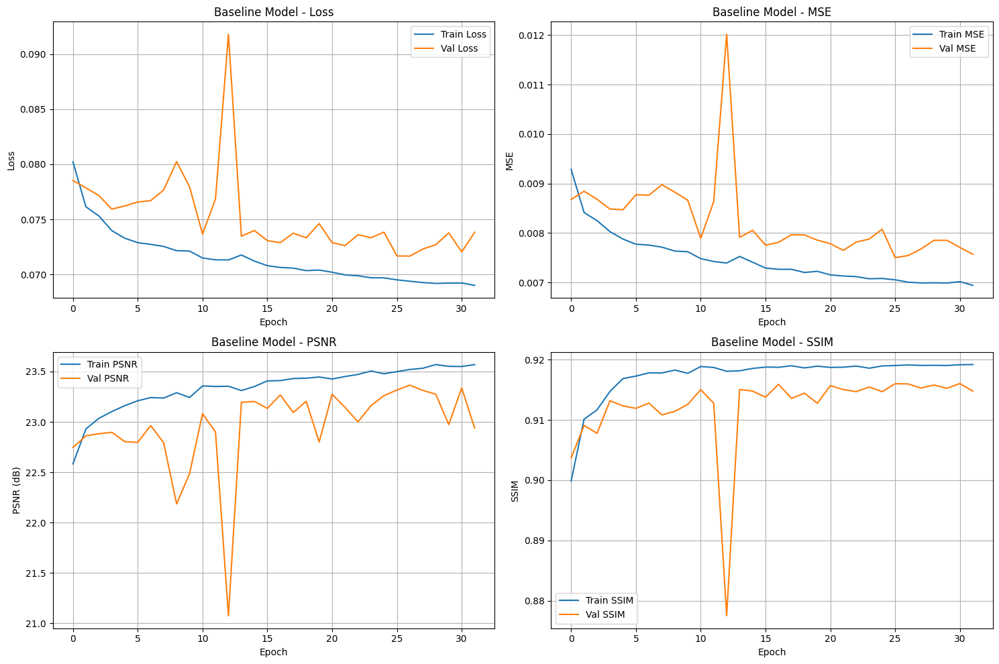

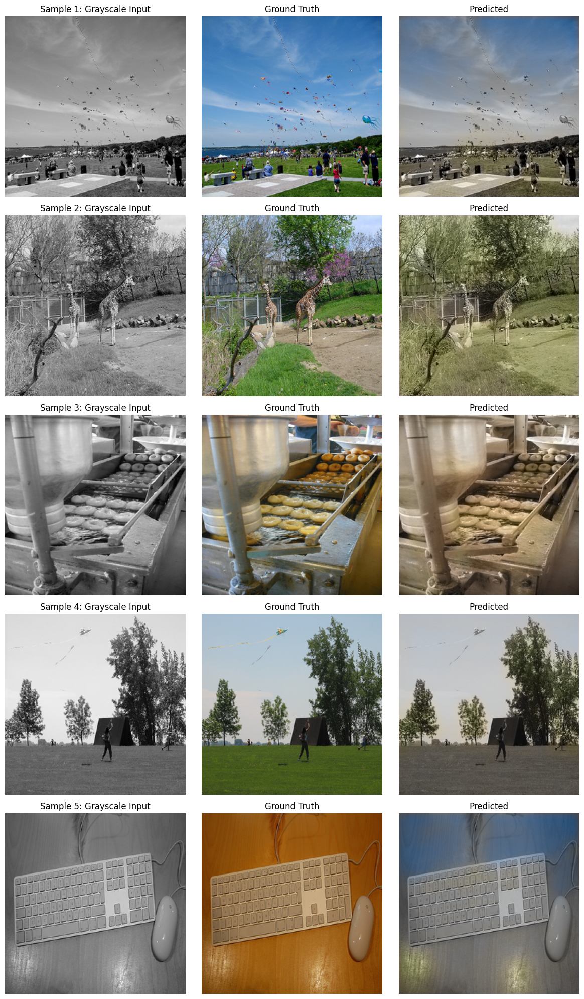

In [ ]:
# Train baseline model with L1 loss
baseline_model = ColorizationModel().to(device)
baseline_history = train_model(
    baseline_model,
    train_loader,
    val_loader,
    num_epochs=NUM_EPOCHS,
    lr=LEARNING_RATE,
    use_perceptual=False,
    model_name='baseline_model'
)

torch.save(baseline_model.state_dict(), f'{MODEL_PATH}/baseline_model.pth')
torch.save(baseline_history, f'{MODEL_PATH}/baseline_history.pth')
# Plot training curves
plot_training_curves(baseline_history, 'Baseline Model')

# Visualize results
visualize_results(baseline_model, test_dataset, device, num_samples=5)

### 10.2 Train Model with Pretrained Global Extractor (VGG16)

Training vgg16_model with AMP (Mixed Precision)...
Using perceptual loss: False

Epoch 1/32


Validation: 100%|██████████| 8/8 [00:29<00:00,  3.71s/it, loss=0.0727]


Train Loss: 0.0901, Val Loss: 0.0780
Train - MSE: 0.0110, PSNR: 21.89, SSIM: 0.8653
Val   - MSE: 0.0087, PSNR: 22.93, SSIM: 0.9035
Saved best model with val_loss: 0.0780

Epoch 2/32


Validation: 100%|██████████| 8/8 [00:29<00:00,  3.70s/it, loss=0.0723]


Train Loss: 0.0760, Val Loss: 0.0776
Train - MSE: 0.0083, PSNR: 23.04, SSIM: 0.9119
Val   - MSE: 0.0086, PSNR: 22.93, SSIM: 0.9077
Saved best model with val_loss: 0.0776

Epoch 3/32


Validation: 100%|██████████| 8/8 [00:30<00:00,  3.81s/it, loss=0.0724]


Train Loss: 0.0750, Val Loss: 0.0775
Train - MSE: 0.0082, PSNR: 23.11, SSIM: 0.9119
Val   - MSE: 0.0088, PSNR: 23.02, SSIM: 0.9116
Saved best model with val_loss: 0.0775

Epoch 4/32


Validation: 100%|██████████| 8/8 [00:29<00:00,  3.70s/it, loss=0.0714]


Train Loss: 0.0744, Val Loss: 0.0765
Train - MSE: 0.0081, PSNR: 23.11, SSIM: 0.9141
Val   - MSE: 0.0086, PSNR: 22.97, SSIM: 0.9123
Saved best model with val_loss: 0.0765

Epoch 5/32


Validation: 100%|██████████| 8/8 [00:29<00:00,  3.72s/it, loss=0.0721]


Train Loss: 0.0738, Val Loss: 0.0769
Train - MSE: 0.0079, PSNR: 23.14, SSIM: 0.9149
Val   - MSE: 0.0087, PSNR: 23.10, SSIM: 0.9131

Epoch 6/32


Validation: 100%|██████████| 8/8 [00:30<00:00,  3.80s/it, loss=0.0713]


Train Loss: 0.0731, Val Loss: 0.0761
Train - MSE: 0.0078, PSNR: 23.24, SSIM: 0.9161
Val   - MSE: 0.0082, PSNR: 22.91, SSIM: 0.9120
Saved best model with val_loss: 0.0761

Epoch 7/32


Validation: 100%|██████████| 8/8 [00:30<00:00,  3.80s/it, loss=0.0704]


Train Loss: 0.0731, Val Loss: 0.0751
Train - MSE: 0.0077, PSNR: 23.20, SSIM: 0.9159
Val   - MSE: 0.0083, PSNR: 23.21, SSIM: 0.9143
Saved best model with val_loss: 0.0751

Epoch 8/32


Validation: 100%|██████████| 8/8 [00:29<00:00,  3.69s/it, loss=0.0701]


Train Loss: 0.0720, Val Loss: 0.0745
Train - MSE: 0.0075, PSNR: 23.33, SSIM: 0.9176
Val   - MSE: 0.0080, PSNR: 23.16, SSIM: 0.9140
Saved best model with val_loss: 0.0745

Epoch 9/32


Validation: 100%|██████████| 8/8 [00:30<00:00,  3.78s/it, loss=0.0722]


Train Loss: 0.0719, Val Loss: 0.0764
Train - MSE: 0.0075, PSNR: 23.32, SSIM: 0.9168
Val   - MSE: 0.0086, PSNR: 23.10, SSIM: 0.9137

Epoch 10/32


Validation: 100%|██████████| 8/8 [00:29<00:00,  3.71s/it, loss=0.0705]


Train Loss: 0.0716, Val Loss: 0.0746
Train - MSE: 0.0075, PSNR: 23.38, SSIM: 0.9172
Val   - MSE: 0.0079, PSNR: 23.04, SSIM: 0.9135

Epoch 11/32


Validation: 100%|██████████| 8/8 [00:29<00:00,  3.70s/it, loss=0.0709]


Train Loss: 0.0716, Val Loss: 0.0751
Train - MSE: 0.0074, PSNR: 23.38, SSIM: 0.9181
Val   - MSE: 0.0080, PSNR: 22.97, SSIM: 0.9141

Epoch 12/32


Validation: 100%|██████████| 8/8 [00:29<00:00,  3.69s/it, loss=0.0704]


Train Loss: 0.0714, Val Loss: 0.0742
Train - MSE: 0.0074, PSNR: 23.36, SSIM: 0.9181
Val   - MSE: 0.0080, PSNR: 23.22, SSIM: 0.9145
Saved best model with val_loss: 0.0742

Epoch 13/32


Validation: 100%|██████████| 8/8 [00:30<00:00,  3.77s/it, loss=0.0706]


Train Loss: 0.0713, Val Loss: 0.0744
Train - MSE: 0.0074, PSNR: 23.38, SSIM: 0.9179
Val   - MSE: 0.0080, PSNR: 23.20, SSIM: 0.9147

Epoch 14/32


Validation: 100%|██████████| 8/8 [00:30<00:00,  3.82s/it, loss=0.0751]


Train Loss: 0.0721, Val Loss: 0.0783
Train - MSE: 0.0075, PSNR: 23.28, SSIM: 0.9159
Val   - MSE: 0.0088, PSNR: 22.68, SSIM: 0.9063

Epoch 15/32


Validation: 100%|██████████| 8/8 [00:29<00:00,  3.68s/it, loss=0.0702]


Train Loss: 0.0715, Val Loss: 0.0740
Train - MSE: 0.0074, PSNR: 23.38, SSIM: 0.9180
Val   - MSE: 0.0079, PSNR: 23.19, SSIM: 0.9148
Saved best model with val_loss: 0.0740

Epoch 16/32


Validation: 100%|██████████| 8/8 [00:29<00:00,  3.70s/it, loss=0.072]


Train Loss: 0.0712, Val Loss: 0.0757
Train - MSE: 0.0073, PSNR: 23.36, SSIM: 0.9178
Val   - MSE: 0.0080, PSNR: 22.83, SSIM: 0.9135

Epoch 17/32


Validation: 100%|██████████| 8/8 [00:30<00:00,  3.76s/it, loss=0.0705]


Train Loss: 0.0708, Val Loss: 0.0741
Train - MSE: 0.0073, PSNR: 23.44, SSIM: 0.9184
Val   - MSE: 0.0079, PSNR: 23.21, SSIM: 0.9142

Epoch 18/32


Validation: 100%|██████████| 8/8 [00:29<00:00,  3.70s/it, loss=0.0713]


Train Loss: 0.0705, Val Loss: 0.0753
Train - MSE: 0.0072, PSNR: 23.42, SSIM: 0.9185
Val   - MSE: 0.0080, PSNR: 22.89, SSIM: 0.9142

Epoch 19/32


Validation: 100%|██████████| 8/8 [00:30<00:00,  3.78s/it, loss=0.0716]


Train Loss: 0.0706, Val Loss: 0.0744
Train - MSE: 0.0073, PSNR: 23.46, SSIM: 0.9186
Val   - MSE: 0.0080, PSNR: 23.11, SSIM: 0.9135

Epoch 20/32


Validation: 100%|██████████| 8/8 [00:29<00:00,  3.70s/it, loss=0.0712]


Train Loss: 0.0704, Val Loss: 0.0753
Train - MSE: 0.0072, PSNR: 23.46, SSIM: 0.9190
Val   - MSE: 0.0079, PSNR: 22.87, SSIM: 0.9143

Epoch 21/32


Validation: 100%|██████████| 8/8 [00:29<00:00,  3.68s/it, loss=0.0707]


Train Loss: 0.0701, Val Loss: 0.0752
Train - MSE: 0.0071, PSNR: 23.47, SSIM: 0.9189
Val   - MSE: 0.0080, PSNR: 23.00, SSIM: 0.9101

Epoch 22/32


Validation: 100%|██████████| 8/8 [00:30<00:00,  3.81s/it, loss=0.0702]


Train Loss: 0.0699, Val Loss: 0.0734
Train - MSE: 0.0071, PSNR: 23.54, SSIM: 0.9192
Val   - MSE: 0.0077, PSNR: 23.23, SSIM: 0.9149
Saved best model with val_loss: 0.0734

Epoch 23/32


Validation: 100%|██████████| 8/8 [00:30<00:00,  3.77s/it, loss=0.0717]


Train Loss: 0.0699, Val Loss: 0.0755
Train - MSE: 0.0071, PSNR: 23.50, SSIM: 0.9187
Val   - MSE: 0.0080, PSNR: 22.79, SSIM: 0.9136

Epoch 24/32


Validation: 100%|██████████| 8/8 [00:30<00:00,  3.79s/it, loss=0.0705]


Train Loss: 0.0695, Val Loss: 0.0747
Train - MSE: 0.0070, PSNR: 23.53, SSIM: 0.9192
Val   - MSE: 0.0079, PSNR: 22.98, SSIM: 0.9150

Epoch 25/32


Validation: 100%|██████████| 8/8 [00:29<00:00,  3.69s/it, loss=0.07]


Train Loss: 0.0696, Val Loss: 0.0732
Train - MSE: 0.0070, PSNR: 23.53, SSIM: 0.9186
Val   - MSE: 0.0076, PSNR: 23.17, SSIM: 0.9149
Saved best model with val_loss: 0.0732

Epoch 26/32


Validation: 100%|██████████| 8/8 [00:29<00:00,  3.70s/it, loss=0.0699]


Train Loss: 0.0695, Val Loss: 0.0734
Train - MSE: 0.0070, PSNR: 23.52, SSIM: 0.9189
Val   - MSE: 0.0077, PSNR: 23.25, SSIM: 0.9149

Epoch 27/32


Validation: 100%|██████████| 8/8 [00:29<00:00,  3.68s/it, loss=0.0717]


Train Loss: 0.0694, Val Loss: 0.0750
Train - MSE: 0.0070, PSNR: 23.56, SSIM: 0.9188
Val   - MSE: 0.0083, PSNR: 23.10, SSIM: 0.9141

Epoch 28/32


Validation: 100%|██████████| 8/8 [00:29<00:00,  3.69s/it, loss=0.0737]


Train Loss: 0.0698, Val Loss: 0.0766
Train - MSE: 0.0070, PSNR: 23.52, SSIM: 0.9190
Val   - MSE: 0.0086, PSNR: 22.81, SSIM: 0.9112

Epoch 29/32


Validation: 100%|██████████| 8/8 [00:30<00:00,  3.79s/it, loss=0.0704]


Train Loss: 0.0694, Val Loss: 0.0731
Train - MSE: 0.0070, PSNR: 23.51, SSIM: 0.9191
Val   - MSE: 0.0077, PSNR: 23.31, SSIM: 0.9147
Saved best model with val_loss: 0.0731

Epoch 30/32


Validation: 100%|██████████| 8/8 [00:29<00:00,  3.70s/it, loss=0.0701]


Train Loss: 0.0689, Val Loss: 0.0730
Train - MSE: 0.0069, PSNR: 23.59, SSIM: 0.9190
Val   - MSE: 0.0076, PSNR: 23.18, SSIM: 0.9141
Saved best model with val_loss: 0.0730

Epoch 31/32


Validation: 100%|██████████| 8/8 [00:29<00:00,  3.70s/it, loss=0.0705]


Train Loss: 0.0688, Val Loss: 0.0730
Train - MSE: 0.0069, PSNR: 23.59, SSIM: 0.9187
Val   - MSE: 0.0077, PSNR: 23.27, SSIM: 0.9144
Saved best model with val_loss: 0.0730

Epoch 32/32


Validation: 100%|██████████| 8/8 [00:29<00:00,  3.68s/it, loss=0.0706]


Train Loss: 0.0696, Val Loss: 0.0750
Train - MSE: 0.0070, PSNR: 23.50, SSIM: 0.9179
Val   - MSE: 0.0079, PSNR: 22.99, SSIM: 0.9117


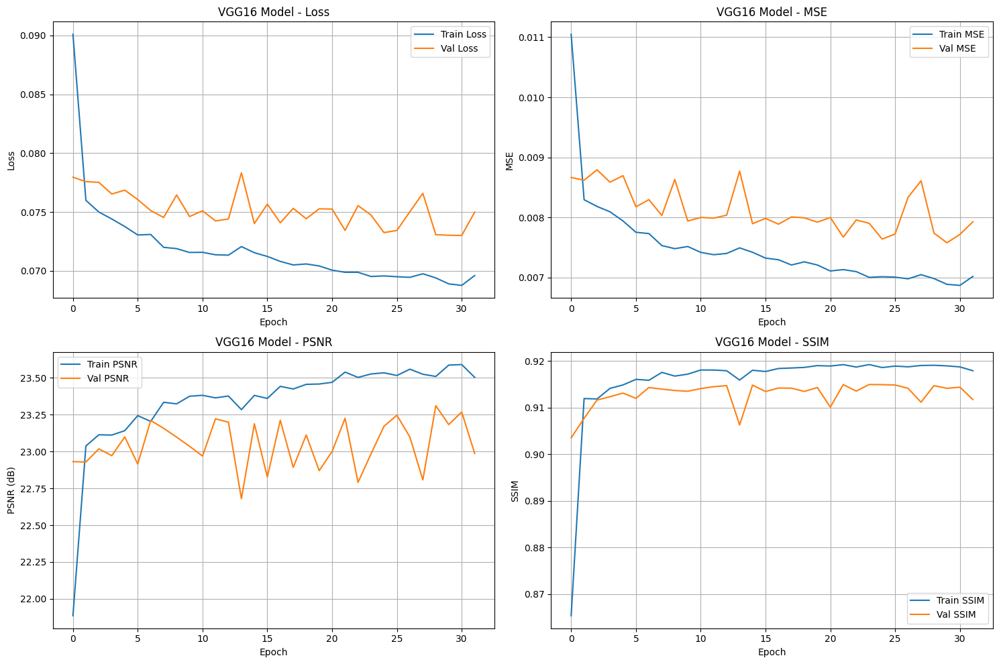

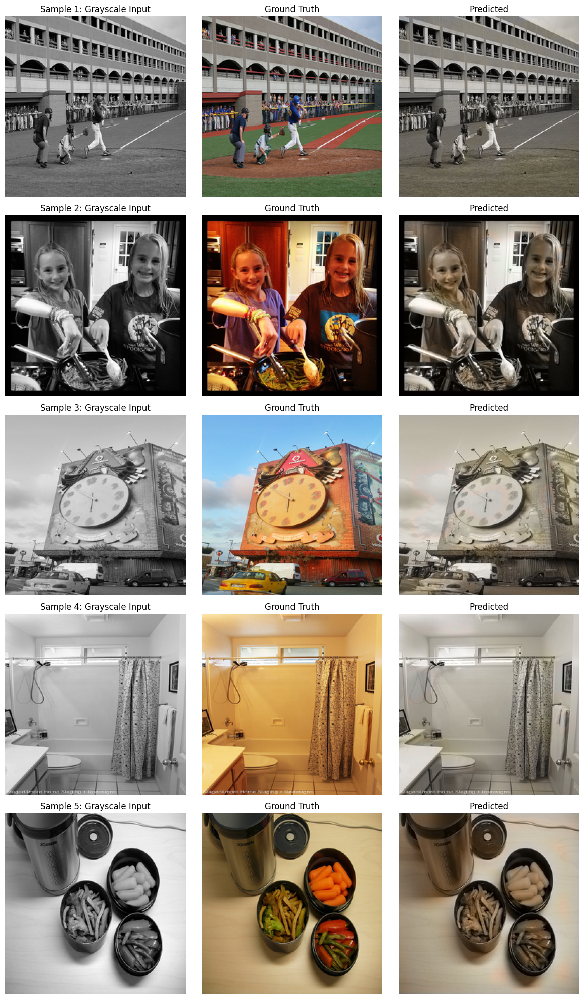

In [ ]:
# Train model with VGG16 backbone
vgg_extractor = PretrainedGlobalExtractor(backbone='vgg16', freeze_backbone=True).to(device)
vgg_model = ColorizationModel(use_pretrained_global=vgg_extractor).to(device)

vgg_history = train_model(
    vgg_model,
    train_loader,
    val_loader,
    num_epochs=NUM_EPOCHS,
    lr=LEARNING_RATE,
    use_perceptual=False,
    model_name='vgg16_model'
)


torch.save(vgg_model.state_dict(), f'{MODEL_PATH}/vgg16_model.pth')
torch.save(vgg_history, f'{MODEL_PATH}/vgg_history.pth')
# Plot training curves
plot_training_curves(vgg_history, 'VGG16 Model')

# Visualize results
visualize_results(vgg_model, test_dataset, device, num_samples=5)

### 10.3 Train Model with Perceptual Loss

Initializing Perceptual Model...
Loading weights from: /content/drive/MyDrive/val2017/models/vgg16_model.pth
Successfully loaded VGG16 model weights! Starting fine-tuning with Perceptual Loss...
Training perceptual_model with AMP (Mixed Precision)...
Using perceptual loss: True
Perceptual loss weight: 0.1

Epoch 1/32


Validation: 100%|██████████| 8/8 [00:31<00:00,  3.95s/it, loss=0.269]


Train Loss: 0.2437, Val Loss: 0.2749
Train - MSE: 0.0080, PSNR: 23.04, SSIM: 0.9063
Val   - MSE: 0.0113, PSNR: 21.22, SSIM: 0.8585
Saved best model with val_loss: 0.2749

Epoch 2/32


Validation: 100%|██████████| 8/8 [00:31<00:00,  3.92s/it, loss=0.218]


Train Loss: 0.2323, Val Loss: 0.2336
Train - MSE: 0.0074, PSNR: 23.28, SSIM: 0.9086
Val   - MSE: 0.0080, PSNR: 23.05, SSIM: 0.9046
Saved best model with val_loss: 0.2336

Epoch 3/32


Validation: 100%|██████████| 8/8 [00:31<00:00,  3.95s/it, loss=0.215]


Train Loss: 0.2303, Val Loss: 0.2302
Train - MSE: 0.0073, PSNR: 23.30, SSIM: 0.9102
Val   - MSE: 0.0079, PSNR: 23.21, SSIM: 0.9108
Saved best model with val_loss: 0.2302

Epoch 4/32


Validation: 100%|██████████| 8/8 [00:30<00:00,  3.80s/it, loss=0.211]


Train Loss: 0.2265, Val Loss: 0.2268
Train - MSE: 0.0072, PSNR: 23.42, SSIM: 0.9121
Val   - MSE: 0.0078, PSNR: 23.18, SSIM: 0.9099
Saved best model with val_loss: 0.2268

Epoch 5/32


Validation: 100%|██████████| 8/8 [00:30<00:00,  3.83s/it, loss=0.209]


Train Loss: 0.2232, Val Loss: 0.2235
Train - MSE: 0.0072, PSNR: 23.41, SSIM: 0.9122
Val   - MSE: 0.0077, PSNR: 23.18, SSIM: 0.9085
Saved best model with val_loss: 0.2235

Epoch 6/32


Validation: 100%|██████████| 8/8 [00:30<00:00,  3.83s/it, loss=0.207]


Train Loss: 0.2203, Val Loss: 0.2216
Train - MSE: 0.0071, PSNR: 23.45, SSIM: 0.9122
Val   - MSE: 0.0079, PSNR: 23.15, SSIM: 0.9071
Saved best model with val_loss: 0.2216

Epoch 7/32


Validation: 100%|██████████| 8/8 [00:31<00:00,  3.89s/it, loss=0.204]


Train Loss: 0.2173, Val Loss: 0.2182
Train - MSE: 0.0072, PSNR: 23.40, SSIM: 0.9118
Val   - MSE: 0.0077, PSNR: 23.12, SSIM: 0.9081
Saved best model with val_loss: 0.2182

Epoch 8/32


Validation: 100%|██████████| 8/8 [00:31<00:00,  3.90s/it, loss=0.202]


Train Loss: 0.2148, Val Loss: 0.2164
Train - MSE: 0.0071, PSNR: 23.44, SSIM: 0.9124
Val   - MSE: 0.0076, PSNR: 23.12, SSIM: 0.9086
Saved best model with val_loss: 0.2164

Epoch 9/32


Validation: 100%|██████████| 8/8 [00:30<00:00,  3.84s/it, loss=0.203]


Train Loss: 0.2119, Val Loss: 0.2157
Train - MSE: 0.0071, PSNR: 23.46, SSIM: 0.9129
Val   - MSE: 0.0077, PSNR: 23.08, SSIM: 0.9065
Saved best model with val_loss: 0.2157

Epoch 10/32


Validation: 100%|██████████| 8/8 [00:30<00:00,  3.85s/it, loss=0.199]


Train Loss: 0.2117, Val Loss: 0.2123
Train - MSE: 0.0071, PSNR: 23.42, SSIM: 0.9123
Val   - MSE: 0.0077, PSNR: 23.21, SSIM: 0.9068
Saved best model with val_loss: 0.2123

Epoch 11/32


Validation: 100%|██████████| 8/8 [00:31<00:00,  3.88s/it, loss=0.205]


Train Loss: 0.2092, Val Loss: 0.2180
Train - MSE: 0.0070, PSNR: 23.48, SSIM: 0.9124
Val   - MSE: 0.0081, PSNR: 22.93, SSIM: 0.9027

Epoch 12/32


Validation: 100%|██████████| 8/8 [00:31<00:00,  3.91s/it, loss=0.197]


Train Loss: 0.2109, Val Loss: 0.2103
Train - MSE: 0.0071, PSNR: 23.43, SSIM: 0.9116
Val   - MSE: 0.0076, PSNR: 23.23, SSIM: 0.9086
Saved best model with val_loss: 0.2103

Epoch 13/32


Validation: 100%|██████████| 8/8 [00:31<00:00,  3.92s/it, loss=0.198]


Train Loss: 0.2069, Val Loss: 0.2094
Train - MSE: 0.0070, PSNR: 23.50, SSIM: 0.9129
Val   - MSE: 0.0075, PSNR: 23.09, SSIM: 0.9079
Saved best model with val_loss: 0.2094

Epoch 14/32


Validation: 100%|██████████| 8/8 [00:31<00:00,  3.91s/it, loss=0.197]


Train Loss: 0.2039, Val Loss: 0.2093
Train - MSE: 0.0068, PSNR: 23.60, SSIM: 0.9134
Val   - MSE: 0.0076, PSNR: 22.99, SSIM: 0.9085
Saved best model with val_loss: 0.2093

Epoch 15/32


Validation: 100%|██████████| 8/8 [00:30<00:00,  3.83s/it, loss=0.194]


Train Loss: 0.2026, Val Loss: 0.2064
Train - MSE: 0.0068, PSNR: 23.60, SSIM: 0.9129
Val   - MSE: 0.0075, PSNR: 23.24, SSIM: 0.9093
Saved best model with val_loss: 0.2064

Epoch 16/32


Validation: 100%|██████████| 8/8 [00:30<00:00,  3.81s/it, loss=0.193]


Train Loss: 0.2027, Val Loss: 0.2059
Train - MSE: 0.0069, PSNR: 23.54, SSIM: 0.9135
Val   - MSE: 0.0077, PSNR: 23.25, SSIM: 0.9097
Saved best model with val_loss: 0.2059

Epoch 17/32


Validation: 100%|██████████| 8/8 [00:31<00:00,  3.94s/it, loss=0.193]


Train Loss: 0.2017, Val Loss: 0.2040
Train - MSE: 0.0069, PSNR: 23.56, SSIM: 0.9134
Val   - MSE: 0.0075, PSNR: 23.27, SSIM: 0.9085
Saved best model with val_loss: 0.2040

Epoch 18/32


Validation: 100%|██████████| 8/8 [00:30<00:00,  3.83s/it, loss=0.192]


Train Loss: 0.1999, Val Loss: 0.2043
Train - MSE: 0.0068, PSNR: 23.61, SSIM: 0.9138
Val   - MSE: 0.0075, PSNR: 23.16, SSIM: 0.9086

Epoch 19/32


Validation: 100%|██████████| 8/8 [00:30<00:00,  3.81s/it, loss=0.193]


Train Loss: 0.1992, Val Loss: 0.2062
Train - MSE: 0.0067, PSNR: 23.63, SSIM: 0.9136
Val   - MSE: 0.0077, PSNR: 23.22, SSIM: 0.9071

Epoch 20/32


Validation: 100%|██████████| 8/8 [00:30<00:00,  3.82s/it, loss=0.192]


Train Loss: 0.1998, Val Loss: 0.2039
Train - MSE: 0.0068, PSNR: 23.61, SSIM: 0.9132
Val   - MSE: 0.0076, PSNR: 23.27, SSIM: 0.9079
Saved best model with val_loss: 0.2039

Epoch 21/32


Validation: 100%|██████████| 8/8 [00:30<00:00,  3.81s/it, loss=0.192]


Train Loss: 0.1991, Val Loss: 0.2038
Train - MSE: 0.0068, PSNR: 23.60, SSIM: 0.9137
Val   - MSE: 0.0078, PSNR: 23.12, SSIM: 0.9089
Saved best model with val_loss: 0.2038

Epoch 22/32


Validation: 100%|██████████| 8/8 [00:31<00:00,  3.91s/it, loss=0.19]


Train Loss: 0.1986, Val Loss: 0.2019
Train - MSE: 0.0068, PSNR: 23.64, SSIM: 0.9141
Val   - MSE: 0.0074, PSNR: 23.23, SSIM: 0.9098
Saved best model with val_loss: 0.2019

Epoch 23/32


Validation: 100%|██████████| 8/8 [00:30<00:00,  3.83s/it, loss=0.191]


Train Loss: 0.1979, Val Loss: 0.2030
Train - MSE: 0.0068, PSNR: 23.63, SSIM: 0.9138
Val   - MSE: 0.0075, PSNR: 23.13, SSIM: 0.9094

Epoch 24/32


Validation: 100%|██████████| 8/8 [00:30<00:00,  3.84s/it, loss=0.19]


Train Loss: 0.1959, Val Loss: 0.2006
Train - MSE: 0.0066, PSNR: 23.68, SSIM: 0.9145
Val   - MSE: 0.0073, PSNR: 23.27, SSIM: 0.9095
Saved best model with val_loss: 0.2006

Epoch 25/32


Validation: 100%|██████████| 8/8 [00:30<00:00,  3.84s/it, loss=0.189]


Train Loss: 0.1969, Val Loss: 0.1994
Train - MSE: 0.0067, PSNR: 23.66, SSIM: 0.9129
Val   - MSE: 0.0073, PSNR: 23.36, SSIM: 0.9096
Saved best model with val_loss: 0.1994

Epoch 26/32


Validation: 100%|██████████| 8/8 [00:30<00:00,  3.82s/it, loss=0.2]


Train Loss: 0.1956, Val Loss: 0.2107
Train - MSE: 0.0067, PSNR: 23.67, SSIM: 0.9142
Val   - MSE: 0.0080, PSNR: 22.55, SSIM: 0.9041

Epoch 27/32


Validation: 100%|██████████| 8/8 [00:30<00:00,  3.85s/it, loss=0.188]


Train Loss: 0.1960, Val Loss: 0.1997
Train - MSE: 0.0067, PSNR: 23.65, SSIM: 0.9144
Val   - MSE: 0.0073, PSNR: 23.26, SSIM: 0.9105

Epoch 28/32


Validation: 100%|██████████| 8/8 [00:30<00:00,  3.82s/it, loss=0.188]


Train Loss: 0.1956, Val Loss: 0.1990
Train - MSE: 0.0067, PSNR: 23.64, SSIM: 0.9140
Val   - MSE: 0.0073, PSNR: 23.38, SSIM: 0.9088
Saved best model with val_loss: 0.1990

Epoch 29/32


Validation: 100%|██████████| 8/8 [00:30<00:00,  3.83s/it, loss=0.189]


Train Loss: 0.1981, Val Loss: 0.1991
Train - MSE: 0.0068, PSNR: 23.61, SSIM: 0.9133
Val   - MSE: 0.0073, PSNR: 23.32, SSIM: 0.9099

Epoch 30/32


Validation: 100%|██████████| 8/8 [00:30<00:00,  3.83s/it, loss=0.188]


Train Loss: 0.1951, Val Loss: 0.1996
Train - MSE: 0.0066, PSNR: 23.71, SSIM: 0.9145
Val   - MSE: 0.0074, PSNR: 23.33, SSIM: 0.9111

Epoch 31/32


Validation: 100%|██████████| 8/8 [00:31<00:00,  3.94s/it, loss=0.193]


Train Loss: 0.1941, Val Loss: 0.2020
Train - MSE: 0.0066, PSNR: 23.73, SSIM: 0.9145
Val   - MSE: 0.0074, PSNR: 23.22, SSIM: 0.9093

Epoch 32/32


Validation: 100%|██████████| 8/8 [00:30<00:00,  3.84s/it, loss=0.191]


Train Loss: 0.1933, Val Loss: 0.2032
Train - MSE: 0.0065, PSNR: 23.77, SSIM: 0.9148
Val   - MSE: 0.0079, PSNR: 23.13, SSIM: 0.9091


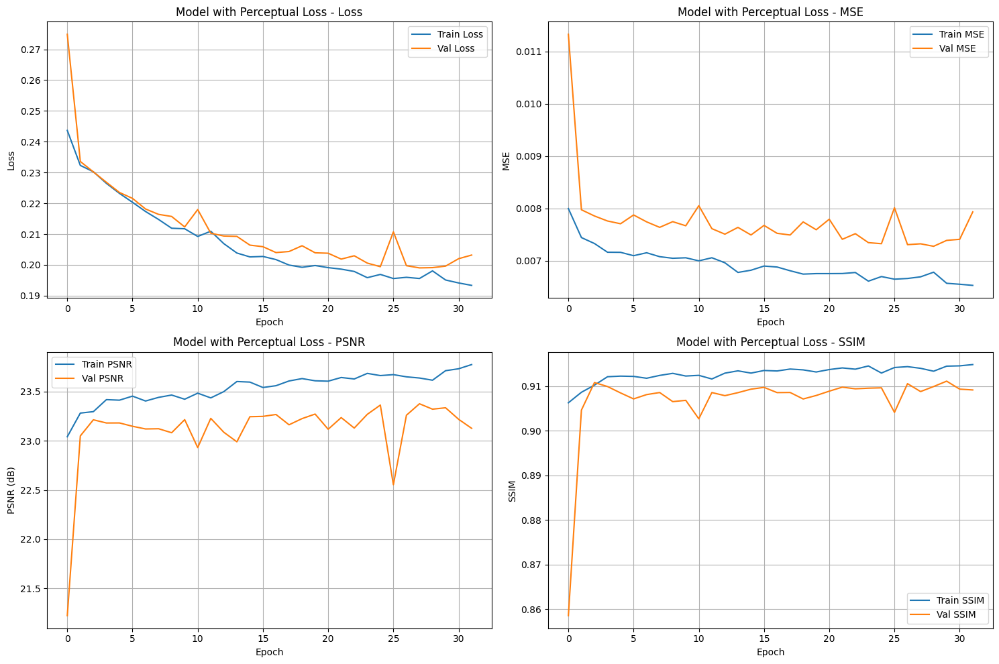

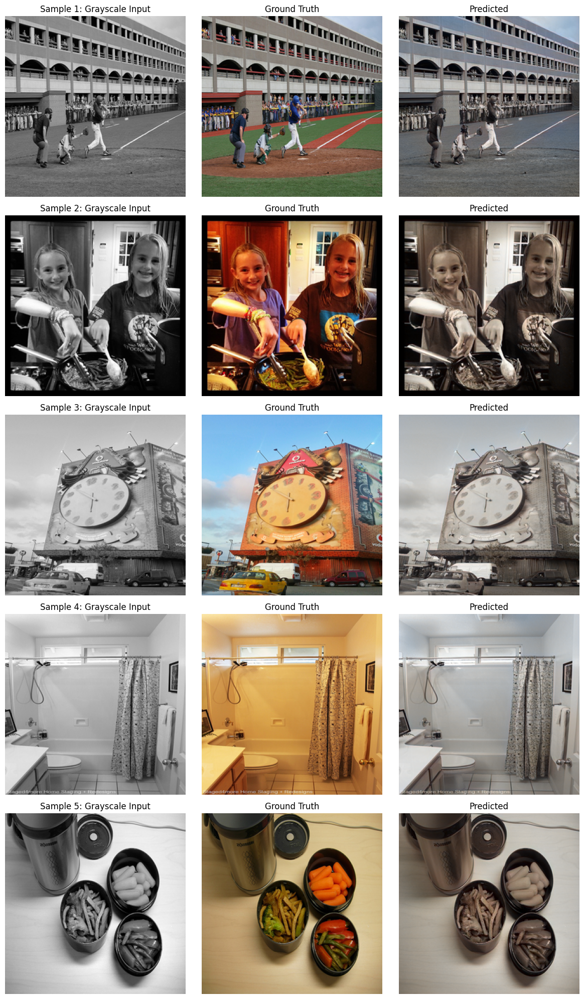

In [ ]:
vgg_checkpoint_path = '/content/drive/MyDrive/val2017/models/vgg16_model.pth'

# Initialize the Backbone
vgg_extractor = PretrainedGlobalExtractor(backbone='vgg16', freeze_backbone=True).to(device)

# Initialize the Model Architecture
print("Initializing Perceptual Model...")
perceptual_model = ColorizationModel(use_pretrained_global=vgg_extractor).to(device)

# Load the Weights from Drive
if os.path.exists(vgg_checkpoint_path):
    print(f"Loading weights from: {vgg_checkpoint_path}")

    # Load the file
    checkpoint = torch.load(vgg_checkpoint_path, map_location=device)

    # Handle both 'full checkpoint dict' and 'raw state_dict' cases
    if isinstance(checkpoint, dict) and 'model_state_dict' in checkpoint:
        perceptual_model.load_state_dict(checkpoint['model_state_dict'])
    else:
        perceptual_model.load_state_dict(checkpoint)

    print("Successfully loaded VGG16 model weights. Starting fine-tuning with Perceptual Loss...")
else:
    print(f"WARNING: File not found at {vgg_checkpoint_path}. Training from scratch.")

perceptual_history = train_model(
    perceptual_model,
    train_loader,
    val_loader,
    num_epochs=NUM_EPOCHS,
    lr=LEARNING_RATE,
    use_perceptual=True,
    perceptual_weight=0.1,
    model_name='perceptual_model'
)

# Save the results
torch.save(perceptual_model.state_dict(), f'{MODEL_PATH}/perceptual_model.pth')
torch.save(perceptual_history, f'{MODEL_PATH}/perceptual_history.pth')

# Plot and Visualize
plot_training_curves(perceptual_history, 'Model with Perceptual Loss')
visualize_results(perceptual_model, test_dataset, device, num_samples=5)

### 10.4 Train Model with PatchGAN (Bonus)

Loading generator weights from: /content/drive/MyDrive/val2017/models/perceptual_model.pth
Successfully loaded Perceptual Model weights. Starting GAN training...
Training patchgan_model with PatchGAN...

Epoch 1/100


Training: 100%|██████████| 32/32 [00:18<00:00,  1.76it/s, G_loss=8.33, D_loss=0.679]


G Loss: 7.3943, D Loss: 0.6855, Val Loss: 0.0709
Val - MSE: 0.0074, PSNR: 23.42, SSIM: 0.9152
Saved best model with val_loss: 0.0709

Epoch 2/100


Training: 100%|██████████| 32/32 [00:18<00:00,  1.70it/s, G_loss=7.51, D_loss=0.701]


G Loss: 7.6355, D Loss: 0.5993, Val Loss: 0.0762
Val - MSE: 0.0081, PSNR: 22.75, SSIM: 0.9084

Epoch 3/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.66it/s, G_loss=8.71, D_loss=0.718]


G Loss: 8.1254, D Loss: 0.5718, Val Loss: 0.0782
Val - MSE: 0.0086, PSNR: 22.47, SSIM: 0.9027

Epoch 4/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.68it/s, G_loss=8.59, D_loss=0.435]


G Loss: 8.2479, D Loss: 0.5611, Val Loss: 0.0726
Val - MSE: 0.0076, PSNR: 23.16, SSIM: 0.9064

Epoch 5/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.65it/s, G_loss=8.84, D_loss=0.508]


G Loss: 8.3335, D Loss: 0.5734, Val Loss: 0.0771
Val - MSE: 0.0083, PSNR: 22.56, SSIM: 0.8968

Epoch 6/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.64it/s, G_loss=7.52, D_loss=0.706]


G Loss: 8.4295, D Loss: 0.5859, Val Loss: 0.0813
Val - MSE: 0.0091, PSNR: 22.15, SSIM: 0.8917

Epoch 7/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.63it/s, G_loss=8.47, D_loss=0.499]


G Loss: 8.4999, D Loss: 0.5982, Val Loss: 0.0819
Val - MSE: 0.0093, PSNR: 21.95, SSIM: 0.8864

Epoch 8/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.61it/s, G_loss=8.69, D_loss=0.655]


G Loss: 8.5129, D Loss: 0.5908, Val Loss: 0.0805
Val - MSE: 0.0086, PSNR: 22.27, SSIM: 0.8977

Epoch 9/100


Training: 100%|██████████| 32/32 [00:18<00:00,  1.70it/s, G_loss=9.86, D_loss=0.709]


G Loss: 8.5476, D Loss: 0.5936, Val Loss: 0.0818
Val - MSE: 0.0094, PSNR: 21.92, SSIM: 0.8868

Epoch 10/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.66it/s, G_loss=9.47, D_loss=0.782]


G Loss: 8.5969, D Loss: 0.6047, Val Loss: 0.0879
Val - MSE: 0.0104, PSNR: 21.10, SSIM: 0.8740

Epoch 11/100


Training: 100%|██████████| 32/32 [00:18<00:00,  1.73it/s, G_loss=8.83, D_loss=1.07]


G Loss: 8.6583, D Loss: 0.6265, Val Loss: 0.0820
Val - MSE: 0.0093, PSNR: 21.77, SSIM: 0.8813

Epoch 12/100


Training: 100%|██████████| 32/32 [00:18<00:00,  1.70it/s, G_loss=8.13, D_loss=0.804]


G Loss: 8.5456, D Loss: 0.5902, Val Loss: 0.0830
Val - MSE: 0.0092, PSNR: 21.72, SSIM: 0.8815

Epoch 13/100


Training: 100%|██████████| 32/32 [00:18<00:00,  1.72it/s, G_loss=8.21, D_loss=0.74]


G Loss: 8.5983, D Loss: 0.6113, Val Loss: 0.1030
Val - MSE: 0.0131, PSNR: 19.96, SSIM: 0.8498

Epoch 14/100


Training: 100%|██████████| 32/32 [00:18<00:00,  1.74it/s, G_loss=8.21, D_loss=1.05]


G Loss: 8.6380, D Loss: 0.6352, Val Loss: 0.0903
Val - MSE: 0.0108, PSNR: 21.02, SSIM: 0.8612

Epoch 15/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.62it/s, G_loss=9.55, D_loss=0.447]


G Loss: 8.6249, D Loss: 0.5982, Val Loss: 0.0825
Val - MSE: 0.0094, PSNR: 21.81, SSIM: 0.8752

Epoch 16/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.67it/s, G_loss=8.18, D_loss=0.742]


G Loss: 8.6284, D Loss: 0.6333, Val Loss: 0.0827
Val - MSE: 0.0095, PSNR: 21.72, SSIM: 0.8767

Epoch 17/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.63it/s, G_loss=8.39, D_loss=0.97]


G Loss: 8.5920, D Loss: 0.6239, Val Loss: 0.0814
Val - MSE: 0.0090, PSNR: 21.90, SSIM: 0.8767

Epoch 18/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.64it/s, G_loss=9.56, D_loss=0.633]


G Loss: 8.6269, D Loss: 0.6188, Val Loss: 0.0886
Val - MSE: 0.0108, PSNR: 21.01, SSIM: 0.8639

Epoch 19/100


Training: 100%|██████████| 32/32 [00:18<00:00,  1.75it/s, G_loss=9.4, D_loss=0.647]


G Loss: 8.5967, D Loss: 0.6123, Val Loss: 0.0936
Val - MSE: 0.0117, PSNR: 20.59, SSIM: 0.8595

Epoch 20/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.63it/s, G_loss=9, D_loss=0.754]


G Loss: 8.5701, D Loss: 0.6298, Val Loss: 0.0882
Val - MSE: 0.0107, PSNR: 20.97, SSIM: 0.8661

Epoch 21/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.62it/s, G_loss=8.04, D_loss=1.13]


G Loss: 8.5866, D Loss: 0.6350, Val Loss: 0.0818
Val - MSE: 0.0103, PSNR: 21.36, SSIM: 0.8698

Epoch 22/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.64it/s, G_loss=9.21, D_loss=0.417]


G Loss: 8.6158, D Loss: 0.6094, Val Loss: 0.1032
Val - MSE: 0.0137, PSNR: 19.90, SSIM: 0.8346

Epoch 23/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.65it/s, G_loss=8.4, D_loss=0.642]


G Loss: 8.5565, D Loss: 0.6203, Val Loss: 0.0811
Val - MSE: 0.0089, PSNR: 21.99, SSIM: 0.8844

Epoch 24/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.61it/s, G_loss=8.79, D_loss=0.672]


G Loss: 8.5739, D Loss: 0.6167, Val Loss: 0.0792
Val - MSE: 0.0090, PSNR: 22.11, SSIM: 0.8867

Epoch 25/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.64it/s, G_loss=8.72, D_loss=0.514]


G Loss: 8.5633, D Loss: 0.6155, Val Loss: 0.0866
Val - MSE: 0.0104, PSNR: 21.18, SSIM: 0.8676

Epoch 26/100


Training: 100%|██████████| 32/32 [00:18<00:00,  1.69it/s, G_loss=8.05, D_loss=0.738]


G Loss: 8.5663, D Loss: 0.6246, Val Loss: 0.0922
Val - MSE: 0.0113, PSNR: 20.70, SSIM: 0.8532

Epoch 27/100


Training: 100%|██████████| 32/32 [00:18<00:00,  1.75it/s, G_loss=9.01, D_loss=0.698]


G Loss: 8.5813, D Loss: 0.6254, Val Loss: 0.0833
Val - MSE: 0.0093, PSNR: 21.69, SSIM: 0.8793

Epoch 28/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.65it/s, G_loss=8.45, D_loss=0.898]


G Loss: 8.5301, D Loss: 0.6117, Val Loss: 0.0925
Val - MSE: 0.0108, PSNR: 20.95, SSIM: 0.8645

Epoch 29/100


Training: 100%|██████████| 32/32 [00:18<00:00,  1.71it/s, G_loss=7.75, D_loss=0.667]


G Loss: 8.4793, D Loss: 0.5998, Val Loss: 0.0857
Val - MSE: 0.0111, PSNR: 21.09, SSIM: 0.8704

Epoch 30/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.68it/s, G_loss=8.71, D_loss=0.715]


G Loss: 8.5144, D Loss: 0.6204, Val Loss: 0.0812
Val - MSE: 0.0095, PSNR: 21.76, SSIM: 0.8767

Epoch 31/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.66it/s, G_loss=9.2, D_loss=0.549]


G Loss: 8.5933, D Loss: 0.6039, Val Loss: 0.0822
Val - MSE: 0.0095, PSNR: 21.68, SSIM: 0.8721

Epoch 32/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.66it/s, G_loss=9.12, D_loss=0.444]


G Loss: 8.5490, D Loss: 0.6082, Val Loss: 0.0845
Val - MSE: 0.0100, PSNR: 21.57, SSIM: 0.8689

Epoch 33/100


Training: 100%|██████████| 32/32 [00:18<00:00,  1.70it/s, G_loss=9.2, D_loss=0.691]


G Loss: 8.5550, D Loss: 0.6302, Val Loss: 0.0863
Val - MSE: 0.0099, PSNR: 21.53, SSIM: 0.8761

Epoch 34/100


Training: 100%|██████████| 32/32 [00:18<00:00,  1.76it/s, G_loss=9.01, D_loss=0.56]


G Loss: 8.5280, D Loss: 0.5990, Val Loss: 0.0924
Val - MSE: 0.0119, PSNR: 20.69, SSIM: 0.8533

Epoch 35/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.66it/s, G_loss=8.28, D_loss=0.768]


G Loss: 8.4788, D Loss: 0.6139, Val Loss: 0.0917
Val - MSE: 0.0103, PSNR: 21.12, SSIM: 0.8682

Epoch 36/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.64it/s, G_loss=8.13, D_loss=0.665]


G Loss: 8.4707, D Loss: 0.6235, Val Loss: 0.0870
Val - MSE: 0.0109, PSNR: 20.98, SSIM: 0.8665

Epoch 37/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.62it/s, G_loss=9.46, D_loss=0.563]


G Loss: 8.5173, D Loss: 0.6118, Val Loss: 0.0843
Val - MSE: 0.0100, PSNR: 21.47, SSIM: 0.8711

Epoch 38/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.63it/s, G_loss=9.7, D_loss=0.473]


G Loss: 8.5215, D Loss: 0.6045, Val Loss: 0.0860
Val - MSE: 0.0100, PSNR: 21.37, SSIM: 0.8645

Epoch 39/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.61it/s, G_loss=7.71, D_loss=0.937]


G Loss: 8.4785, D Loss: 0.6444, Val Loss: 0.0837
Val - MSE: 0.0098, PSNR: 21.60, SSIM: 0.8713

Epoch 40/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.64it/s, G_loss=8.82, D_loss=0.658]


G Loss: 8.4413, D Loss: 0.5945, Val Loss: 0.0937
Val - MSE: 0.0119, PSNR: 20.61, SSIM: 0.8519

Epoch 41/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.66it/s, G_loss=9.14, D_loss=0.613]


G Loss: 8.5060, D Loss: 0.6079, Val Loss: 0.0905
Val - MSE: 0.0112, PSNR: 20.95, SSIM: 0.8619

Epoch 42/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.64it/s, G_loss=10.4, D_loss=0.513]


G Loss: 8.4935, D Loss: 0.6168, Val Loss: 0.0889
Val - MSE: 0.0105, PSNR: 21.21, SSIM: 0.8684

Epoch 43/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.62it/s, G_loss=8.15, D_loss=0.869]


G Loss: 8.4226, D Loss: 0.6303, Val Loss: 0.0903
Val - MSE: 0.0109, PSNR: 21.01, SSIM: 0.8618

Epoch 44/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.66it/s, G_loss=8.86, D_loss=0.804]


G Loss: 8.4079, D Loss: 0.6073, Val Loss: 0.0859
Val - MSE: 0.0104, PSNR: 21.25, SSIM: 0.8684

Epoch 45/100


Training: 100%|██████████| 32/32 [00:18<00:00,  1.74it/s, G_loss=8.13, D_loss=0.702]


G Loss: 8.4153, D Loss: 0.6178, Val Loss: 0.0829
Val - MSE: 0.0094, PSNR: 21.67, SSIM: 0.8783

Epoch 46/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.68it/s, G_loss=8.27, D_loss=0.415]


G Loss: 8.4199, D Loss: 0.6166, Val Loss: 0.0823
Val - MSE: 0.0094, PSNR: 21.74, SSIM: 0.8795

Epoch 47/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.64it/s, G_loss=8.53, D_loss=0.572]


G Loss: 8.3367, D Loss: 0.6133, Val Loss: 0.0863
Val - MSE: 0.0104, PSNR: 21.35, SSIM: 0.8710

Epoch 48/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.68it/s, G_loss=8.99, D_loss=0.635]


G Loss: 8.3624, D Loss: 0.5965, Val Loss: 0.0878
Val - MSE: 0.0102, PSNR: 21.20, SSIM: 0.8634

Epoch 49/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.61it/s, G_loss=7.74, D_loss=0.603]


G Loss: 8.3586, D Loss: 0.6115, Val Loss: 0.0869
Val - MSE: 0.0096, PSNR: 21.63, SSIM: 0.8760

Epoch 50/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.65it/s, G_loss=9.23, D_loss=0.539]


G Loss: 8.3731, D Loss: 0.6015, Val Loss: 0.0866
Val - MSE: 0.0098, PSNR: 21.33, SSIM: 0.8723

Epoch 51/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.63it/s, G_loss=9.29, D_loss=0.738]


G Loss: 8.3793, D Loss: 0.6304, Val Loss: 0.0939
Val - MSE: 0.0117, PSNR: 20.67, SSIM: 0.8566

Epoch 52/100


Training: 100%|██████████| 32/32 [00:18<00:00,  1.71it/s, G_loss=7.52, D_loss=0.685]


G Loss: 8.2504, D Loss: 0.5948, Val Loss: 0.0875
Val - MSE: 0.0104, PSNR: 21.33, SSIM: 0.8640

Epoch 53/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.67it/s, G_loss=8.42, D_loss=0.551]


G Loss: 8.3380, D Loss: 0.6152, Val Loss: 0.0873
Val - MSE: 0.0110, PSNR: 21.16, SSIM: 0.8622

Epoch 54/100


Training: 100%|██████████| 32/32 [00:18<00:00,  1.71it/s, G_loss=8.53, D_loss=0.931]


G Loss: 8.3078, D Loss: 0.6177, Val Loss: 0.0994
Val - MSE: 0.0133, PSNR: 19.99, SSIM: 0.8422

Epoch 55/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.68it/s, G_loss=8.35, D_loss=0.796]


G Loss: 8.3504, D Loss: 0.5937, Val Loss: 0.0817
Val - MSE: 0.0091, PSNR: 21.94, SSIM: 0.8808

Epoch 56/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.62it/s, G_loss=7.55, D_loss=0.73]


G Loss: 8.3246, D Loss: 0.6106, Val Loss: 0.0872
Val - MSE: 0.0098, PSNR: 21.47, SSIM: 0.8750

Epoch 57/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.65it/s, G_loss=9, D_loss=0.565]


G Loss: 8.2706, D Loss: 0.5957, Val Loss: 0.0891
Val - MSE: 0.0101, PSNR: 21.20, SSIM: 0.8668

Epoch 58/100


Training: 100%|██████████| 32/32 [00:18<00:00,  1.72it/s, G_loss=8.52, D_loss=0.612]


G Loss: 8.2580, D Loss: 0.6043, Val Loss: 0.0786
Val - MSE: 0.0090, PSNR: 22.25, SSIM: 0.8920

Epoch 59/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.67it/s, G_loss=8.5, D_loss=0.786]


G Loss: 8.2314, D Loss: 0.5983, Val Loss: 0.0903
Val - MSE: 0.0111, PSNR: 20.80, SSIM: 0.8568

Epoch 60/100


Training: 100%|██████████| 32/32 [00:18<00:00,  1.70it/s, G_loss=7.63, D_loss=0.596]


G Loss: 8.1600, D Loss: 0.5996, Val Loss: 0.0882
Val - MSE: 0.0110, PSNR: 21.03, SSIM: 0.8686

Epoch 61/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.66it/s, G_loss=7.44, D_loss=0.656]


G Loss: 8.2075, D Loss: 0.6050, Val Loss: 0.0895
Val - MSE: 0.0110, PSNR: 20.89, SSIM: 0.8588

Epoch 62/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.66it/s, G_loss=9.3, D_loss=0.578]


G Loss: 8.2304, D Loss: 0.5881, Val Loss: 0.0877
Val - MSE: 0.0102, PSNR: 21.17, SSIM: 0.8666

Epoch 63/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.67it/s, G_loss=7.51, D_loss=0.673]


G Loss: 8.2383, D Loss: 0.6094, Val Loss: 0.1094
Val - MSE: 0.0133, PSNR: 20.12, SSIM: 0.8634

Epoch 64/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.63it/s, G_loss=8.78, D_loss=0.573]


G Loss: 8.2075, D Loss: 0.5739, Val Loss: 0.0939
Val - MSE: 0.0120, PSNR: 20.77, SSIM: 0.8597

Epoch 65/100


Training: 100%|██████████| 32/32 [00:18<00:00,  1.68it/s, G_loss=7.97, D_loss=0.659]


G Loss: 8.2102, D Loss: 0.5925, Val Loss: 0.0881
Val - MSE: 0.0105, PSNR: 21.33, SSIM: 0.8600

Epoch 66/100


Training: 100%|██████████| 32/32 [00:18<00:00,  1.70it/s, G_loss=8.98, D_loss=0.495]


G Loss: 8.2123, D Loss: 0.5794, Val Loss: 0.0851
Val - MSE: 0.0099, PSNR: 21.54, SSIM: 0.8687

Epoch 67/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.67it/s, G_loss=8.78, D_loss=0.546]


G Loss: 8.1263, D Loss: 0.6358, Val Loss: 0.0911
Val - MSE: 0.0118, PSNR: 20.70, SSIM: 0.8663

Epoch 68/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.68it/s, G_loss=8.05, D_loss=0.711]


G Loss: 8.0934, D Loss: 0.5698, Val Loss: 0.0789
Val - MSE: 0.0085, PSNR: 22.22, SSIM: 0.8861

Epoch 69/100


Training: 100%|██████████| 32/32 [00:18<00:00,  1.72it/s, G_loss=9.55, D_loss=0.71]


G Loss: 8.1472, D Loss: 0.5767, Val Loss: 0.0841
Val - MSE: 0.0096, PSNR: 21.60, SSIM: 0.8684

Epoch 70/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.67it/s, G_loss=7.59, D_loss=0.645]


G Loss: 8.1277, D Loss: 0.5577, Val Loss: 0.0892
Val - MSE: 0.0105, PSNR: 21.13, SSIM: 0.8529

Epoch 71/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.68it/s, G_loss=7.96, D_loss=0.67]


G Loss: 8.1365, D Loss: 0.6015, Val Loss: 0.0941
Val - MSE: 0.0115, PSNR: 20.69, SSIM: 0.8526

Epoch 72/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.68it/s, G_loss=8.79, D_loss=0.552]


G Loss: 8.1316, D Loss: 0.5700, Val Loss: 0.0908
Val - MSE: 0.0112, PSNR: 20.90, SSIM: 0.8545

Epoch 73/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.63it/s, G_loss=8.11, D_loss=0.614]


G Loss: 8.1317, D Loss: 0.5665, Val Loss: 0.0956
Val - MSE: 0.0117, PSNR: 20.55, SSIM: 0.8464

Epoch 74/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.68it/s, G_loss=9.49, D_loss=0.454]


G Loss: 8.1418, D Loss: 0.5654, Val Loss: 0.0948
Val - MSE: 0.0115, PSNR: 20.70, SSIM: 0.8503

Epoch 75/100


Training: 100%|██████████| 32/32 [00:18<00:00,  1.69it/s, G_loss=8.29, D_loss=0.726]


G Loss: 8.0702, D Loss: 0.5835, Val Loss: 0.0867
Val - MSE: 0.0103, PSNR: 21.20, SSIM: 0.8666

Epoch 76/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.67it/s, G_loss=9.41, D_loss=0.45]


G Loss: 8.1030, D Loss: 0.5516, Val Loss: 0.0912
Val - MSE: 0.0113, PSNR: 20.86, SSIM: 0.8485

Epoch 77/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.66it/s, G_loss=8.2, D_loss=0.727]


G Loss: 8.1237, D Loss: 0.5719, Val Loss: 0.0904
Val - MSE: 0.0111, PSNR: 20.84, SSIM: 0.8634

Epoch 78/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.67it/s, G_loss=8.1, D_loss=0.659]


G Loss: 8.0808, D Loss: 0.5875, Val Loss: 0.0966
Val - MSE: 0.0121, PSNR: 20.51, SSIM: 0.8534

Epoch 79/100


Training: 100%|██████████| 32/32 [00:18<00:00,  1.74it/s, G_loss=8.57, D_loss=0.548]


G Loss: 8.0949, D Loss: 0.5263, Val Loss: 0.0949
Val - MSE: 0.0122, PSNR: 20.43, SSIM: 0.8552

Epoch 80/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.67it/s, G_loss=7.66, D_loss=0.541]


G Loss: 8.1016, D Loss: 0.5717, Val Loss: 0.0839
Val - MSE: 0.0093, PSNR: 21.64, SSIM: 0.8700

Epoch 81/100


Training: 100%|██████████| 32/32 [00:18<00:00,  1.70it/s, G_loss=8.68, D_loss=0.748]


G Loss: 8.0511, D Loss: 0.5532, Val Loss: 0.0886
Val - MSE: 0.0104, PSNR: 21.28, SSIM: 0.8613

Epoch 82/100


Training: 100%|██████████| 32/32 [00:18<00:00,  1.70it/s, G_loss=7.62, D_loss=0.745]


G Loss: 8.0717, D Loss: 0.5433, Val Loss: 0.0896
Val - MSE: 0.0107, PSNR: 21.01, SSIM: 0.8598

Epoch 83/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.63it/s, G_loss=7.98, D_loss=0.63]


G Loss: 8.0932, D Loss: 0.5753, Val Loss: 0.0842
Val - MSE: 0.0097, PSNR: 21.49, SSIM: 0.8687

Epoch 84/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.67it/s, G_loss=7.8, D_loss=0.663]


G Loss: 8.0762, D Loss: 0.5099, Val Loss: 0.0854
Val - MSE: 0.0098, PSNR: 21.41, SSIM: 0.8694

Epoch 85/100


Training: 100%|██████████| 32/32 [00:18<00:00,  1.70it/s, G_loss=11.5, D_loss=1.73]


G Loss: 8.1930, D Loss: 0.5735, Val Loss: 0.3250
Val - MSE: 0.0856, PSNR: 11.65, SSIM: 0.4985

Epoch 86/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.67it/s, G_loss=10.1, D_loss=0.421]


G Loss: 9.0757, D Loss: 0.4811, Val Loss: 0.0827
Val - MSE: 0.0095, PSNR: 21.91, SSIM: 0.8875

Epoch 87/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.63it/s, G_loss=8.18, D_loss=0.488]


G Loss: 8.5061, D Loss: 0.5069, Val Loss: 0.0883
Val - MSE: 0.0101, PSNR: 21.19, SSIM: 0.8739

Epoch 88/100


Training: 100%|██████████| 32/32 [00:18<00:00,  1.70it/s, G_loss=9.56, D_loss=0.624]


G Loss: 8.3962, D Loss: 0.5554, Val Loss: 0.0821
Val - MSE: 0.0094, PSNR: 21.71, SSIM: 0.8816

Epoch 89/100


Training: 100%|██████████| 32/32 [00:18<00:00,  1.71it/s, G_loss=8.02, D_loss=0.454]


G Loss: 8.1823, D Loss: 0.5281, Val Loss: 0.0851
Val - MSE: 0.0102, PSNR: 21.39, SSIM: 0.8754

Epoch 90/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.66it/s, G_loss=7.94, D_loss=0.475]


G Loss: 8.2351, D Loss: 0.5429, Val Loss: 0.0863
Val - MSE: 0.0104, PSNR: 21.32, SSIM: 0.8688

Epoch 91/100


Training: 100%|██████████| 32/32 [00:18<00:00,  1.74it/s, G_loss=8.01, D_loss=0.48]


G Loss: 8.1818, D Loss: 0.5046, Val Loss: 0.0917
Val - MSE: 0.0116, PSNR: 20.89, SSIM: 0.8490

Epoch 92/100


Training: 100%|██████████| 32/32 [00:18<00:00,  1.68it/s, G_loss=8.37, D_loss=0.57]


G Loss: 8.1556, D Loss: 0.5428, Val Loss: 0.0800
Val - MSE: 0.0088, PSNR: 22.12, SSIM: 0.8817

Epoch 93/100


Training: 100%|██████████| 32/32 [00:18<00:00,  1.71it/s, G_loss=7.15, D_loss=0.577]


G Loss: 8.1419, D Loss: 0.5321, Val Loss: 0.0869
Val - MSE: 0.0099, PSNR: 21.32, SSIM: 0.8730

Epoch 94/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.64it/s, G_loss=8.24, D_loss=0.545]


G Loss: 8.1699, D Loss: 0.5093, Val Loss: 0.0848
Val - MSE: 0.0098, PSNR: 21.63, SSIM: 0.8714

Epoch 95/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.67it/s, G_loss=8.87, D_loss=0.44]


G Loss: 8.1677, D Loss: 0.5205, Val Loss: 0.0874
Val - MSE: 0.0103, PSNR: 21.36, SSIM: 0.8703

Epoch 96/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.67it/s, G_loss=7.12, D_loss=0.615]


G Loss: 8.0876, D Loss: 0.5773, Val Loss: 0.0913
Val - MSE: 0.0113, PSNR: 20.78, SSIM: 0.8563

Epoch 97/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.62it/s, G_loss=9.39, D_loss=0.779]


G Loss: 8.0738, D Loss: 0.5148, Val Loss: 0.0840
Val - MSE: 0.0094, PSNR: 21.65, SSIM: 0.8744

Epoch 98/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.68it/s, G_loss=8.76, D_loss=0.633]


G Loss: 8.1001, D Loss: 0.4958, Val Loss: 0.0940
Val - MSE: 0.0111, PSNR: 20.65, SSIM: 0.8546

Epoch 99/100


Training: 100%|██████████| 32/32 [00:18<00:00,  1.75it/s, G_loss=9.75, D_loss=0.364]


G Loss: 8.1297, D Loss: 0.5426, Val Loss: 0.0804
Val - MSE: 0.0089, PSNR: 22.05, SSIM: 0.8827

Epoch 100/100


Training: 100%|██████████| 32/32 [00:19<00:00,  1.68it/s, G_loss=9.34, D_loss=0.34]


G Loss: 8.0007, D Loss: 0.5304, Val Loss: 0.0848
Val - MSE: 0.0099, PSNR: 21.61, SSIM: 0.8726


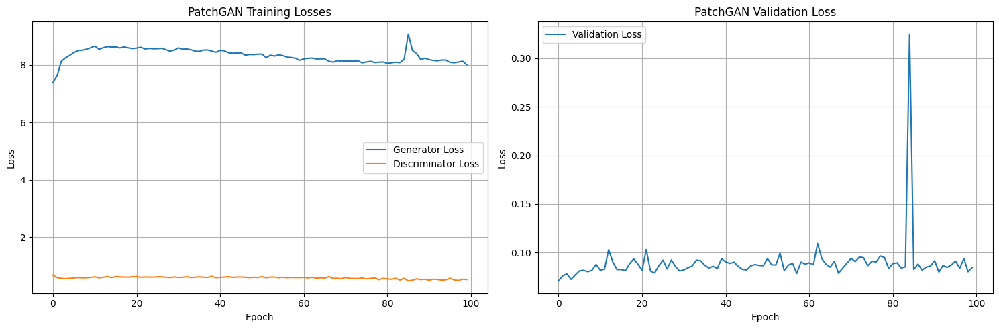

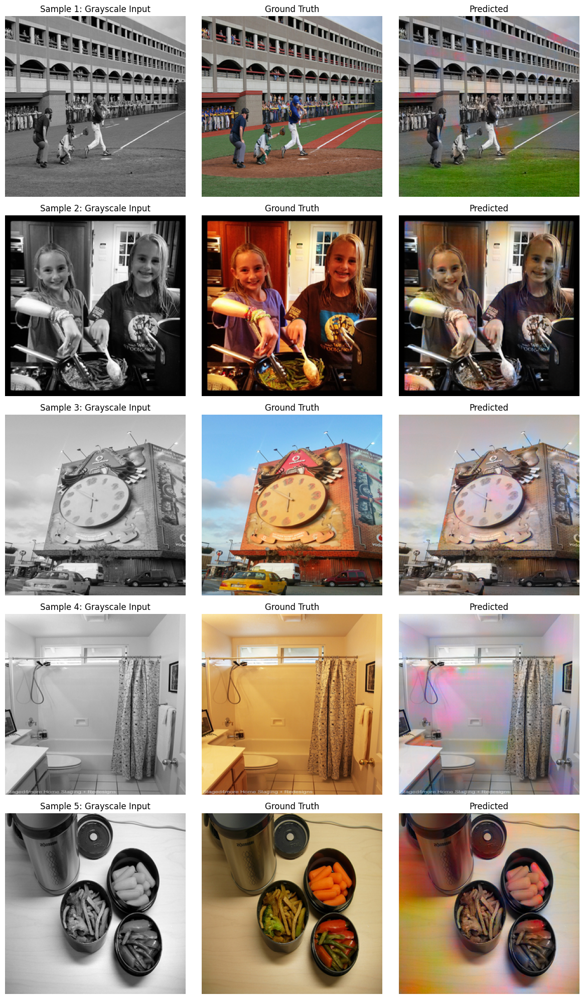

In [ ]:
perceptual_checkpoint_path = f'{MODEL_PATH}/perceptual_model.pth'

# initialize the backbone
vgg_extractor = PretrainedGlobalExtractor(backbone='vgg16', freeze_backbone=True).to(device)

# Initialize the gan
gan_generator = ColorizationModel(use_pretrained_global=vgg_extractor).to(device)
gan_discriminator = PatchGANDiscriminator(input_channels=3).to(device)

# Load weights from Perceptual Model
if os.path.exists(perceptual_checkpoint_path):
    print(f"Loading generator weights from: {perceptual_checkpoint_path}")
    checkpoint = torch.load(perceptual_checkpoint_path, map_location=device)

    # Handle dictionary vs raw state_dict
    if isinstance(checkpoint, dict) and 'model_state_dict' in checkpoint:
        gan_generator.load_state_dict(checkpoint['model_state_dict'])
    else:
        gan_generator.load_state_dict(checkpoint)

    print("Successfully loaded Perceptual Model weights. Starting GAN training...")
else:
    print(f"WARNING: No perceptual model found at {perceptual_checkpoint_path}. Training Generator from scratch.")

#train
gan_history = train_with_patchgan(
    gan_generator,
    gan_discriminator,
    train_loader,
    val_loader,
    num_epochs=100,
    lr_g=0.0002,
    lr_d=0.0002,
    lambda_l1=100,
    model_name='patchgan_model'
)

# Save Results
torch.save(gan_generator.state_dict(), f'{MODEL_PATH}/patchgan_model.pth')
torch.save(gan_discriminator.state_dict(), f'{MODEL_PATH}/patchgan_discriminator.pth')
torch.save(gan_history, f'{MODEL_PATH}/patchgan_history.pth')

# Plot Training Curves
fig, axes = plt.subplots(1, 2, figsize=(15, 5))
axes[0].plot(gan_history['train_g_losses'], label='Generator Loss')
axes[0].plot(gan_history['train_d_losses'], label='Discriminator Loss')
axes[0].set_xlabel('Epoch')
axes[0].set_ylabel('Loss')
axes[0].set_title('PatchGAN Training Losses')
axes[0].legend()
axes[0].grid(True)

axes[1].plot(gan_history['val_losses'], label='Validation Loss')
axes[1].set_xlabel('Epoch')
axes[1].set_ylabel('Loss')
axes[1].set_title('PatchGAN Validation Loss')
axes[1].legend()
axes[1].grid(True)
plt.tight_layout()
plt.show()

# Visualize Results
visualize_results(gan_generator, test_dataset, device, num_samples=5)

## 11. Results and Comparison

### 11.1 Compare All Models

Loading models from:
  Baseline: /content/drive/MyDrive/val2017/models/baseline_model.pth
  VGG16: /content/drive/MyDrive/val2017/models/vgg16_model.pth
  Perceptual: /content/drive/MyDrive/val2017/models/perceptual_model.pth
  PatchGAN: /content/drive/MyDrive/val2017/models/patchgan_model.pth
Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth


100%|██████████| 528M/528M [00:02<00:00, 239MB/s]



Loading weights...

Running comparison...


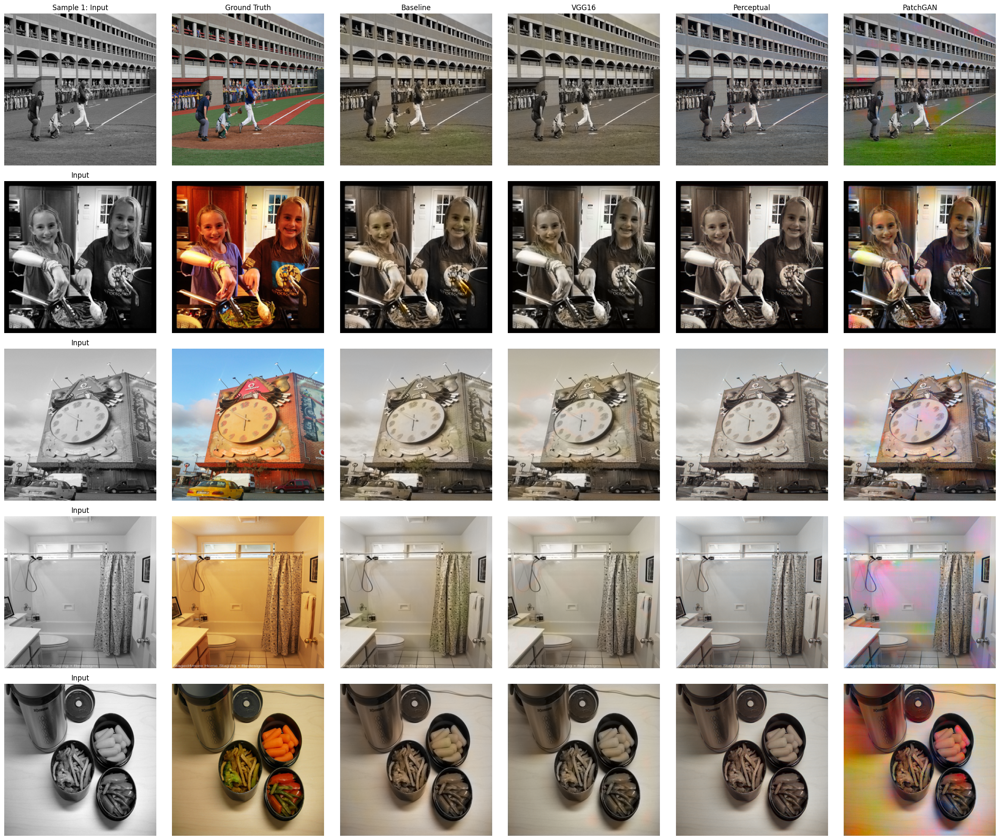

In [19]:
def get_model_path(name):
    path_final = f'{MODEL_PATH}/{name}.pth'
    return path_final

paths = {
    'Baseline': get_model_path('baseline_model'),
    'VGG16': get_model_path('vgg16_model'),
    'Perceptual': get_model_path('perceptual_model'),
    'PatchGAN': get_model_path('patchgan_model')
}

print("Loading models from:")
for k, v in paths.items():
    print(f"  {k}: {v}")

# Initialize Architectures
# Baseline
baseline_model = ColorizationModel().to(device)

# VGG Extractor
vgg_extractor = PretrainedGlobalExtractor(backbone='vgg16', freeze_backbone=True).to(device)

# Initialize VGG-based models
# We create separate instances for each so they hold different weights
vgg_model = ColorizationModel(use_pretrained_global=vgg_extractor).to(device)
perceptual_model = ColorizationModel(use_pretrained_global=vgg_extractor).to(device)
gan_generator = ColorizationModel(use_pretrained_global=vgg_extractor).to(device)

# Function to Load Weights
def load_weights(model, path):
    if not os.path.exists(path):
        print(f"Path not found: {path}")
        return model

    try:
        checkpoint = torch.load(path, map_location=device)
        # Handle dict vs raw state_dict
        if isinstance(checkpoint, dict) and 'model_state_dict' in checkpoint:
            model.load_state_dict(checkpoint['model_state_dict'])
        elif isinstance(checkpoint, dict) and 'generator_state_dict' in checkpoint: # For GAN
            model.load_state_dict(checkpoint['generator_state_dict'])
        else:
            model.load_state_dict(checkpoint)
        model.eval()
        return model
    except Exception as e:
        print(f"Error loading {path}: {e}")
        return model

# Load Weights into Models
print("\nLoading weights...")
baseline_model = load_weights(baseline_model, paths['Baseline'])
vgg_model = load_weights(vgg_model, paths['VGG16'])
perceptual_model = load_weights(perceptual_model, paths['Perceptual'])
gan_generator = load_weights(gan_generator, paths['PatchGAN'])

# Compare Models
models_to_compare = {
    'Baseline': baseline_model,
    'VGG16': vgg_model,
    'Perceptual': perceptual_model,
    'PatchGAN': gan_generator
}

# Run visual comparison
print("\nRunning comparison...")
compare_models(models_to_compare, test_dataset, device, num_samples=5)

### 11.2 Quantitative Results Summary

Evaluating Baseline...
Evaluating VGG16...
Evaluating Perceptual...
Evaluating PatchGAN...

QUANTITATIVE RESULTS SUMMARY
               mse     psnr    ssim
Baseline    0.0076  22.9286  0.9146
VGG16       0.0081  22.8477  0.9112
Perceptual  0.0080  23.1197  0.9091
PatchGAN    0.0099  21.6079  0.8726

Best MSE (lower is better): 0.0076 -> Baseline
Best PSNR (higher is better): 23.1197 -> Perceptual
Best SSIM (higher is better): 0.9146 -> Baseline


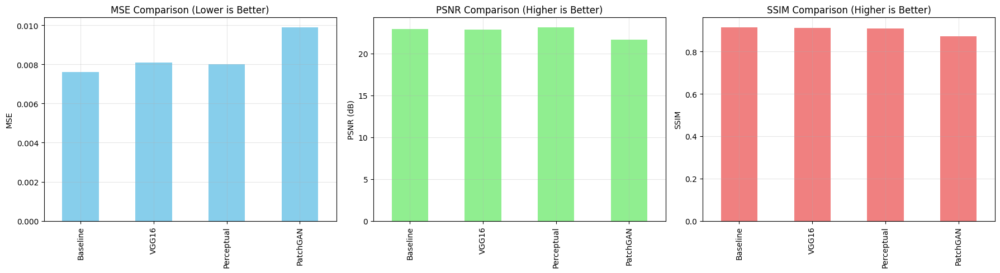

In [20]:
def evaluate_model_on_testset(model, test_loader, device):
    """Evaluate model on entire test set."""
    model.eval()
    total_metrics = {'mse': 0.0, 'psnr': 0.0, 'ssim': 0.0}

    with torch.no_grad():
        for L, ab, _ in test_loader:
            L, ab = L.to(device), ab.to(device)
            ab_pred = model(L)

            metrics = calculate_metrics(ab_pred, ab, L)
            for key in metrics:
                total_metrics[key] += metrics[key]

    # Average over batches
    for key in total_metrics:
        total_metrics[key] /= len(test_loader)

    return total_metrics

# Evaluate all models
results = {}
for model_name, model in models_to_compare.items():
    print(f"Evaluating {model_name}...")
    metrics = evaluate_model_on_testset(model, test_loader, device)
    results[model_name] = metrics

# Create comparison table
results_df = pd.DataFrame(results).T
results_df = results_df.round(4)
print("\n" + "="*60)
print("QUANTITATIVE RESULTS SUMMARY")
print("="*60)
print(results_df)
print("="*60)

# Highlight best values
print("\nBest MSE (lower is better):", results_df['mse'].min(), "->", results_df['mse'].idxmin())
print("Best PSNR (higher is better):", results_df['psnr'].max(), "->", results_df['psnr'].idxmax())
print("Best SSIM (higher is better):", results_df['ssim'].max(), "->", results_df['ssim'].idxmax())

# Visualize metrics comparison
fig, axes = plt.subplots(1, 3, figsize=(18, 5))

results_df['mse'].plot(kind='bar', ax=axes[0], color='skyblue')
axes[0].set_title('MSE Comparison (Lower is Better)')
axes[0].set_ylabel('MSE')
axes[0].grid(True, alpha=0.3)

results_df['psnr'].plot(kind='bar', ax=axes[1], color='lightgreen')
axes[1].set_title('PSNR Comparison (Higher is Better)')
axes[1].set_ylabel('PSNR (dB)')
axes[1].grid(True, alpha=0.3)

results_df['ssim'].plot(kind='bar', ax=axes[2], color='lightcoral')
axes[2].set_title('SSIM Comparison (Higher is Better)')
axes[2].set_ylabel('SSIM')
axes[2].grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

### 11.3 Failure Cases and Analysis

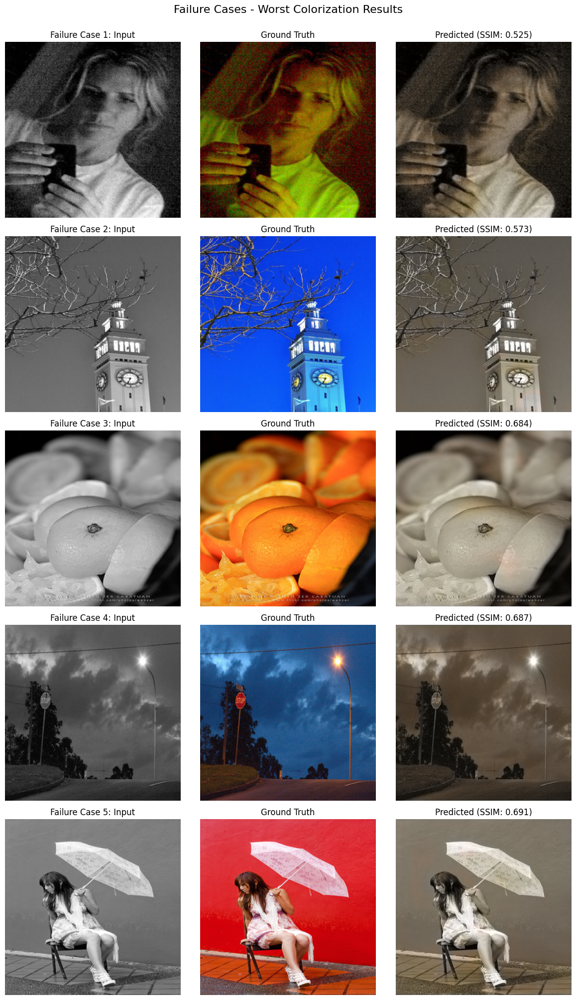

In [21]:
# Identify and visualize failure cases (images with lowest SSIM)
def find_failure_cases(model, dataset, device, num_cases=5):
    """Find images where the model performs poorly."""
    model.eval()

    ssim_scores = []
    with torch.no_grad():
        for i in range(len(dataset)):
            L, ab, _ = dataset[i]
            L_batch = L.unsqueeze(0).to(device)
            ab_batch = ab.unsqueeze(0).to(device)

            ab_pred = model(L_batch)
            metrics = calculate_metrics(ab_pred, ab_batch, L_batch)
            ssim_scores.append((i, metrics['ssim']))

    # Sort by SSIM (ascending - worst first)
    ssim_scores.sort(key=lambda x: x[1])

    # Get worst cases
    worst_indices = [idx for idx, _ in ssim_scores[:num_cases]]

    # Visualize
    fig, axes = plt.subplots(num_cases, 3, figsize=(12, 4 * num_cases))

    with torch.no_grad():
        for plot_idx, data_idx in enumerate(worst_indices):
            L, ab_true, _ = dataset[data_idx]
            L_batch = L.unsqueeze(0).to(device)

            ab_pred = model(L_batch)

            # Convert to numpy
            L_np = (L.squeeze().numpy() * 100.0).astype(np.float32)
            ab_true_np = (ab_true.permute(1, 2, 0).numpy() * 128.0).astype(np.float32)
            ab_pred_np = (ab_pred[0].cpu().permute(1, 2, 0).numpy() * 128.0).astype(np.float32)

            # Reconstruct LAB images
            lab_true = np.zeros((IMG_SIZE, IMG_SIZE, 3), dtype=np.float32)
            lab_true[:, :, 0] = L_np
            lab_true[:, :, 1:] = ab_true_np

            lab_pred = np.zeros((IMG_SIZE, IMG_SIZE, 3), dtype=np.float32)
            lab_pred[:, :, 0] = L_np
            lab_pred[:, :, 1:] = ab_pred_np

            # Convert to RGB
            rgb_true = color.lab2rgb(lab_true)
            rgb_pred = color.lab2rgb(lab_pred)

            # Calculate SSIM for this case
            ssim_val = ssim(rgb_true, rgb_pred, channel_axis=2, data_range=1.0)

            # Plot
            axes[plot_idx, 0].imshow(L_np, cmap='gray')
            axes[plot_idx, 0].set_title(f'Failure Case {plot_idx+1}: Input')
            axes[plot_idx, 0].axis('off')

            axes[plot_idx, 1].imshow(rgb_true)
            axes[plot_idx, 1].set_title('Ground Truth')
            axes[plot_idx, 1].axis('off')

            axes[plot_idx, 2].imshow(rgb_pred)
            axes[plot_idx, 2].set_title(f'Predicted (SSIM: {ssim_val:.3f})')
            axes[plot_idx, 2].axis('off')

    plt.suptitle('Failure Cases - Worst Colorization Results', fontsize=16, y=1.001)
    plt.tight_layout()
    plt.show()

# Find failure cases for best model
find_failure_cases(vgg_model, test_dataset, device, num_cases=5)

## 12. Discussion

### 12.1 Model Performance Analysis

1. Baseline Model (statistical winner): Surprisingly, the Baseline model achieved the best MSE (0.0076) and best SSIM (0.9146).

- Why: This confirms that the L1 loss successfully minimized the pixel-wise error. By predicting desaturated, brownish-gray colors (the statistical average of all possible colors), the model minimized its "risk."

- Visuals: While mathematically "accurate," the qualitative results are poor. The images lacked vibrancy, appearing like washed out images. This highlights the flaw of relying solely on MSE/SSIM for colorization tasks on diverse datasets.

2. Effect of Pretrained Global Extractors (VGG16): The VGG16-based model performed slightly worse than the baseline (MSE 0.0081).

    - Analysis: Even though VGG16 features provide semantic context ("this is a sky"), the complexity of fusing these high-dimensional features likely required more training time or data than available. The model struggled to map these complex features to exact pixel values better than the simple baseline, so there is a slightly higher numerical error.

3. Impact of Perceptual Loss: The Perceptual model achieved the highest PSNR (23.12 dB).

  - Analysis: This indicates that Perceptual Loss helped reduce noise and artifacts. By penalizing feature-level differences rather than just pixel differences, the model reconstructed cleaner images. The color saturation remained low due to the L1 loss influence.

4. PatchGAN Discriminator: Critically, the PatchGAN model achieved the worst scores across all metrics (MSE 0.0099, SSIM 0.8726). This is because GAN prioritize the perceptual realism rather than pixel accuracy. But even doing so the results are still look like washed out. This is because of the dataset that I used in this assignment (COCO DATASET 2017 Validation (5k images)). In the dataset, there is no relation between images (all of them have different context) so model couldn't learn the specific context efficiently. If I trained the model with 5k forest images then the model could guess the forest images but since coco dataset doesn't have any special context, the model's performance is worse.

12.2 Dataset Analysis & Failure Cases

The primary challenge identified across all models was the nature of the COCO val2017 dataset.

  - Lack of Correlation: Unlike domain-specific datasets (faces or forest), COCO images are highly diverse and uncorrelated. An object with a specific shape could be any color (a circle could be a red apple or a green tennis ball). This is why the model's performance are worse than usual.

  - Uncertainty: Faced with this ambiguity, non-GAN models reverted to the mean (gray). They correctly learned that they could not know the color with certainty. This makes the outputs look like washed out.

  - Failure Pattern: The biggest problem I noticed was that the colors often looked washed out. Bright objects, like the kites in the sky or the billboard advertisements, ended up looking grayish instead of vibrant. The GAN model really helped to make this better because it forces the generator to be brave and pick a strong color, rather than just playing it safe with a gray tones.

12.3 Conclusion on Metrics vs. Reality

The results demonstrate that MSE and SSIM are insufficient metrics for creative tasks like colorization on diverse datasets.

  - Best Numerical Model: Baseline (Safe, gray, washed out look).

  - Best Visual Model: PatchGAN (Risky but more Vibrant).

This difference shows that adversarial training (PatchGAN) is necessary to get good-looking results when the correct color isn't obvious. Even though the standard error scores might look worse, the GAN is crucial for making images that actually look real to the human eye, especially when there are many possible correct colors for an object.

## 13. Conclusion and Future Work

### Summary

In this assignment, I built an image colorization system using Deep Convolutional Neural Networks (DCNNs). I used an encoder-decoder architecture that takes a grayscale image (L channel) and tries to predict the missing color channels (a and b).

Here is what I accomplished:

  - Dataset: I set up a dataset using COCO val2017 with 5,000 images and handled the conversion to the Lab* color space.

  - Baseline Model: I built the standard encoder-decoder model shown in the assignment instructions to establish a starting point.

  - Pretrained Models: I improved the model by adding a VGG16 backbone to help the model understand "what" objects are in the image, not just what they look like.

  - Loss Experiments: I tested different ways to calculate error, starting with simple L1 loss, then adding Perceptual Loss to fix blurriness, and finally Adversarial Loss (GAN).

  - Bonus: I implemented a PatchGAN discriminator to force the model to create more realistic and vibrant colors.

Best Performing Model

  - Model configuration: The Baseline Model was the best numerically, but the PatchGAN Model was the best visually.

  - Final metrics (Baseline): MSE=0.0076, PSNR=22.93, SSIM=0.9146.

  - Why it performed best:

      - Numerically: The Baseline model achieved the lowest error scores because the L1 loss encourages it to predict "safe," average colors (like gray). Mathematically, gray is close to everything, so the error stays low, even if the image looks boring.

      - Visually: The PatchGAN model was the real winner for human viewing. Even though its error scores were worse (MSE 0.0099), it was the only model that produced vibrant, realistic colors instead of washed-out sepia tones.

Future Improvements

  - Architecture:

      - I could add U-Net style skip connections. Right now, some fine details get lost in the middle of the network; skip connections would help pass those details directly to the output.

      - Using attention mechanisms would help the model focus more on colorful objects and less on background noise.

  - Training:

      - I mostly used raw images. Adding more data augmentation like rotations or zooming would help the model generalize better.

      - Training for longer (e.g., 100 epochs instead of 32) would likely help the GAN model stabilize and produce even better colors.

  - Dataset:

      - The COCO dataset is very difficult because the images are so different from each other. Using a larger dataset or a more specific one (like just forests) might make training easier and results more consistent.

Lessons Learned

  - Metrics aren't everything: I learned that a good MSE score doesn't mean a good-looking image. The model with the best score was actually the most boring one (grayish), while the best-looking model had the worst score.

  - Lab is useful:* Separating the Lightness from the Color channels makes the problem much easier for the neural network to handle compared to RGB.

  - Adversarial training is key: Standard loss functions play it safe. To get real, vibrant colors, you need a Discriminator (GAN) to force the model to take risks.

  - Pretrained models help context: Using VGG16 helped the model understand the scene better, even if the colors are washed out.